# Analysis from GRAB5-HT1.0 data obtained on 2021_12_11 for GOS062 and GOS063 in S1BF at a 1.8 zoom, 30 Hz, x512.

### All figures stating 'response' mean GRAB-5HT1.0 signal in S1BF
    - dF/F was calculated as (F-Fmean)/Fmean

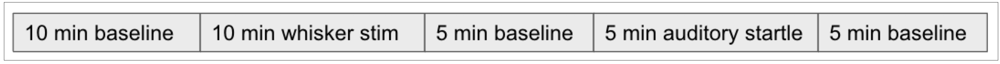

In [124]:
#Session Paradigm
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
plt.figure(figsize=(50,10))
fig = plt.imshow(mpimg.imread('/Users/gabriel---/Desktop/Running_Data/Screenshot 2022-01-11 at 19.20.34.png'))
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)

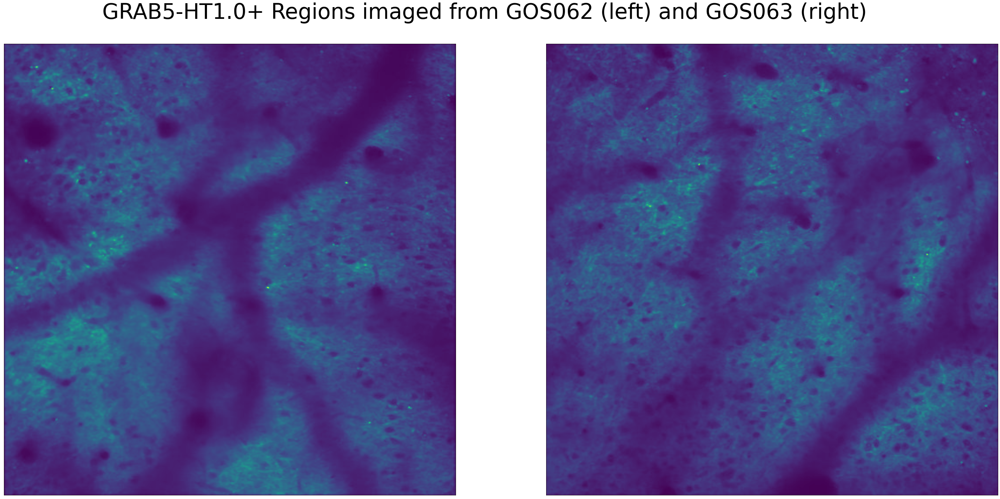

In [109]:
#Images quantified (GOS062 left and GOS063 right)
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
fig=plt.figure(figsize=(50,30))
a = plt.subplot(1,2,1)
plt.imshow(mpimg.imread('/Users/gabriel---/Desktop/Running_Data/2021-12-11_GOS062_t-001_Average.jpg'))
a.axes.get_xaxis().set_visible(False)
a.axes.get_yaxis().set_visible(False)
b = plt.subplot(1,2,2)
plt.imshow(mpimg.imread('/Users/gabriel---/Desktop/Running_Data/2021-12-11_GOS063_t-001_Registered_Average.jpg'))
b.axes.get_xaxis().set_visible(False)
b.axes.get_yaxis().set_visible(False)
fig.suptitle('GRAB5-HT1.0+ Regions imaged from GOS062 (left) and GOS063 (right)',fontsize=60, y=0.85);

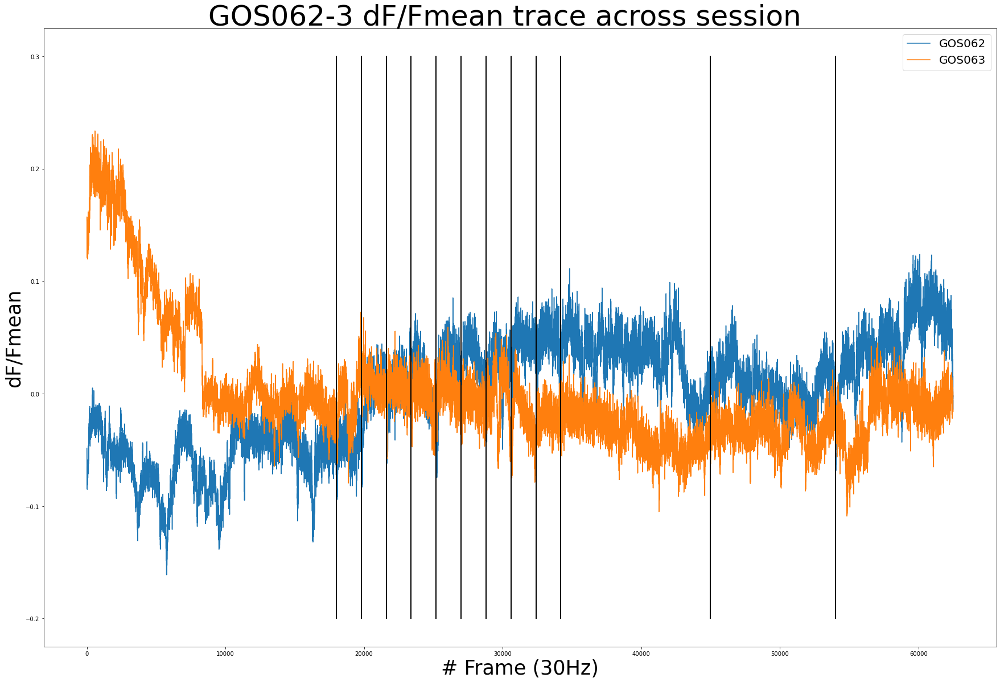

In [1]:
#Plot overall trace of both with approximate Whisker Stim and Sound presentations
import numpy as np
import matplotlib.pyplot as plt
from numpy import genfromtxt
my_data = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021-12-11_GOS062_t-001_quantification.csv', delimiter=',')
my_data2 = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021-12-11_GOS063_t-001_quantification.csv', delimiter=',')
dF_Fmean = (my_data[1:62497,2]-np.mean(my_data[1:62497,2]))/np.mean(my_data[1:62497,2])
dF_Fmean2 = (my_data2[1:62497,2]-np.mean(my_data2[1:62497,2]))/np.mean(my_data2[1:62497,2])
fig = plt.figure(figsize=(30,20)) 
plt.plot(dF_Fmean)
plt.plot(dF_Fmean2)
plt.plot([18000,18000], [-0.2, 0.3], 'k-', lw=2)
x0 = 18000
for i in range(10):
   plt.plot([x0,x0], [-0.2, 0.3], 'k-', lw=2)
   x0+=1800
plt.plot([45000,45000], [-0.2, 0.3], 'k-', lw=2)
plt.plot([54000,54000], [-0.2, 0.3], 'k-', lw=2)
plt.legend(['GOS062','GOS063'], prop={'size': 20})
plt.xlabel('# Frame (30Hz)',fontsize=35)
plt.ylabel('dF/Fmean',fontsize=35)
fig.suptitle('GOS062-3 dF/Fmean trace across session',fontsize=50, y=0.91); 
plt.show()

In [4]:
#I was having problems importing this --> Still pending troubleshoot to change for: import paq_read
def paq_read_function(file_path):
    '''
    Code from Paq2Py Lloyd Russel 2015 - https://github.com/llerussell/paq2py/blob/master/paq2py.py
    Reads in .paq file contents, uses data to define global variables, and returns html output
    Arguments: file_path (string) - binary .paq file contents
    Returns: html outputs
    '''

    # open file
    fid = open(file_path, 'rb')

    # get sample rate
    temprate = int(np.fromfile(fid, dtype='>f', count=1))

    # get number of channels
    tempnum_chans = int(np.fromfile(fid, dtype='>f', count=1))
    
    # get channel names
    tempchan_names = []
    for i in range(tempnum_chans):
        num_chars = int(np.fromfile(fid, dtype='>f', count=1))
        chan_name = ''
        for j in range(num_chars):
            chan_name = chan_name + chr(int(np.fromfile(fid, dtype='>f', count=1))) #adding extra integer typecast as numbers were seen as non-ints
        tempchan_names.append(chan_name)

    # get channel hardware lines
    hw_chans = []
    for i in range(tempnum_chans):
        num_chars = int(np.fromfile(fid, dtype='>f', count=1))
        hw_chan = ''
        for j in range(num_chars):
            hw_chan = hw_chan + chr(int(np.fromfile(fid, dtype='>f', count=1)))
        hw_chans.append(hw_chan)

    # get acquisition units
    units = []
    for i in range(tempnum_chans):
        num_chars = int(np.fromfile(fid, dtype='>f', count=1))
        unit = ''
        for j in range(num_chars):
            unit = unit + chr(int(np.fromfile(fid, dtype='>f', count=1)))
        units.append(unit)

    # get data
    temp_data = np.fromfile(fid, dtype='>f', count=-1)
    tempnum_datapoints = int(len(temp_data)/tempnum_chans)
    temp2_data = np.reshape(temp_data, [tempnum_datapoints, tempnum_chans]).transpose()
    

    # close file
    #fid.close()

    #return {"data": data,
     #       "chan_names": chan_names,
     #       "hw_chans": hw_chans,
     #       "units": units,
     #       "rate": rate}
    return{'data':temp2_data,
          'rate':temprate,
          'num_channels':tempnum_chans,
          'channels_names':tempchan_names,
          'hw_chans':hw_chans,
          'units': units}

In [6]:
#Extracts .paq data (Requires running or importing par_read_function before, see upper cell)
PackData = paq_read_function('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS062_t_001.paq')
PackData2 = paq_read_function('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS063_t_001.paq')


In [5]:
data = PackData['data']
data2= PackData2['data']


In [6]:
#Extracts the .paq points in which there is stimulation or frame recording
temp0= data[0]  #I tried to automatize this with for ii in range(PackData['num_channels']) and str(ii) but I kept getting errors...
temp1=data[1]
temp2=data[2]
temp3 = data[3]
dur = 2100
thresh = 0.2 #This threshold is working fine for whisker and frame but not really for sound (finds too many) nor camera (finds none)
trig_times_0 = []
trig_times_1 = []
trig_times_2 = []
trig_times_3 = []
for i in range(len(data[0])):
  if temp0[i]>thresh and temp0[i-1]<thresh:
     trig_times_0.append(i)
#for i in range(len(data[1])):
  #if temp1[i]>thresh and temp1[i-1]<thresh:
   #  trig_times_1.append(i)
for i in range(len(data[2])):
  if temp2[i]>thresh and temp2[i-1]<thresh:
     trig_times_2.append(i)
#for i in range(len(data[3])):
  #if temp3[i]>thresh and temp3[i-1]<thresh:
   #  trig_times_3.append(i)
temp2[trig_times_0]

array([0.02983362, 0.02391754, 0.02983362, 0.02917628, 0.02358886,
       0.02457488, 0.02720425, 0.02293152, 0.02884761, 0.09458192],
      dtype=float32)

In [7]:
#Finds The frames where whisker is stimulated! (1)
frame_whisker_stim = [] 
for ii in range(len(trig_times_0)):
    num_temp = trig_times_0[ii]
    tmp = min(trig_times_2, key=lambda x:abs(x-num_temp))
    tmp2 = trig_times_2.index(tmp)
    frame_whisker_stim.append(tmp2)


In [8]:
#Extracts the .paq points in which there is stimulation or frame recording (2) For second animal if necessary.
temp0 = data2[0]  #I tried to automatize this with for ii in range(PackData['num_channels']) and str(ii) but I kept getting errors...
temp1 = data2[1]
temp2 = data2[2]
temp3 = data2[3]
dur = 2100
thresh = 0.2 #This threshold is working fine for whisker and frame but not really for sound (finds too many) nor camera (finds none)
trig_times_0 = []
trig_times_1 = []
trig_times_2 = []
trig_times_3 = []
for i in range(len(data2[0])):
  if temp0[i]>thresh and temp0[i-1]<thresh:
     trig_times_0.append(i)
#for i in range(len(data2[1])):
  #if temp1[i]>thresh and temp1[i-1]<thresh:
   #  trig_times_1.append(i)
for i in range(len(data2[2])):
  if temp2[i]>thresh and temp2[i-1]<thresh:
     trig_times_2.append(i)
#for i in range(len(data2[3])):
  #if temp3[i]>thresh and temp3[i-1]<thresh:
   #  trig_times_3.append(i)
temp2[trig_times_0]

array([0.02128816, 0.03443503, 0.01471473, 0.03213432, 0.02063082,
       0.02457488, 0.02621824, 0.02227418, 0.02523222, 0.02260285],
      dtype=float32)

In [9]:
#Finds The frames where whisker is stimulated! (2) For second animal if necessary.
frame_whisker_stim2 = [] 
for ii in range(len(trig_times_0)):
    num_temp = trig_times_0[ii]
    tmp = min(trig_times_2, key=lambda x:abs(x-num_temp))
    tmp2 = trig_times_2.index(tmp)
    frame_whisker_stim2.append(tmp2)

In [12]:
#Generates an array with peri-stimulus response -20s +60s assuming a frame rate of 30Hz. Also generates a peri-random array as control.
import random
fws = np.array(frame_whisker_stim)
fws2 = np.array(frame_whisker_stim2)
rnd = random.sample(range(0, len(dF_Fmean)), 10)
stim_resp = np.zeros([10,2400])
stim_resp2 = np.zeros([10,2400])
cont_resp = np.zeros([10,2400])
for yy in range(len(fws)):
    stim_resp[yy,:] = dF_Fmean[fws[yy]-600:fws[yy]+1800]
    stim_resp2[yy,:] = dF_Fmean2[fws2[yy]-600:fws2[yy]+1800]
    cont_resp[yy,:] = dF_Fmean2[rnd[yy]-600:rnd[yy]+1800]


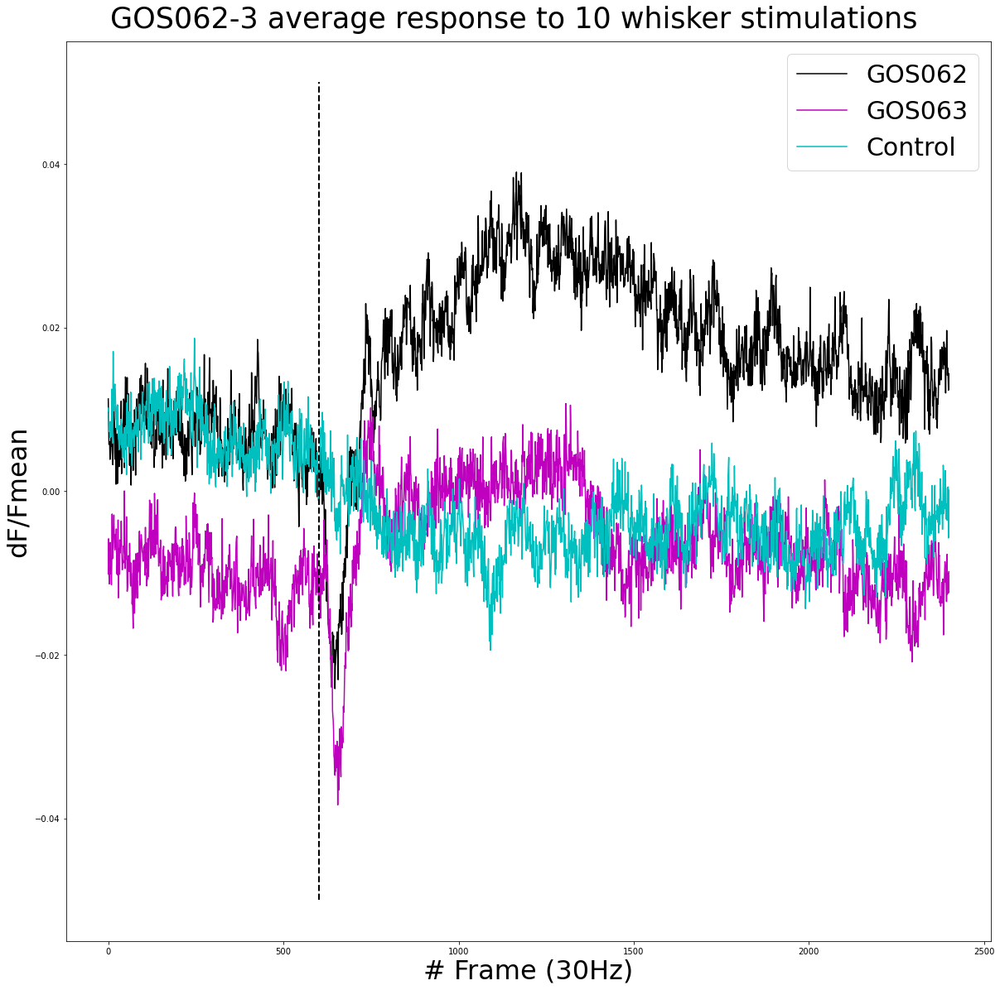

In [96]:
#Plots average response for each animal to the 10 whisker stimulations. with a control.
fig = plt.figure(figsize=(20,20)) 
plt.plot(np.mean(stim_resp,0),'k') #Plot both presentations together
plt.plot(np.mean(stim_resp2,0),'m')
plt.plot(np.mean(cont_resp,0),'c')
plt.plot([601,601], [-0.05, 0.05], 'k--', lw=2)
plt.legend(['GOS062','GOS063','Control'], prop={'size': 30})
plt.xlabel('# Frame (30Hz)',fontsize=32)
plt.ylabel('dF/Fmean',fontsize=32);
fig.suptitle('GOS062-3 average response to 10 whisker stimulations',fontsize=35, y=0.91); 

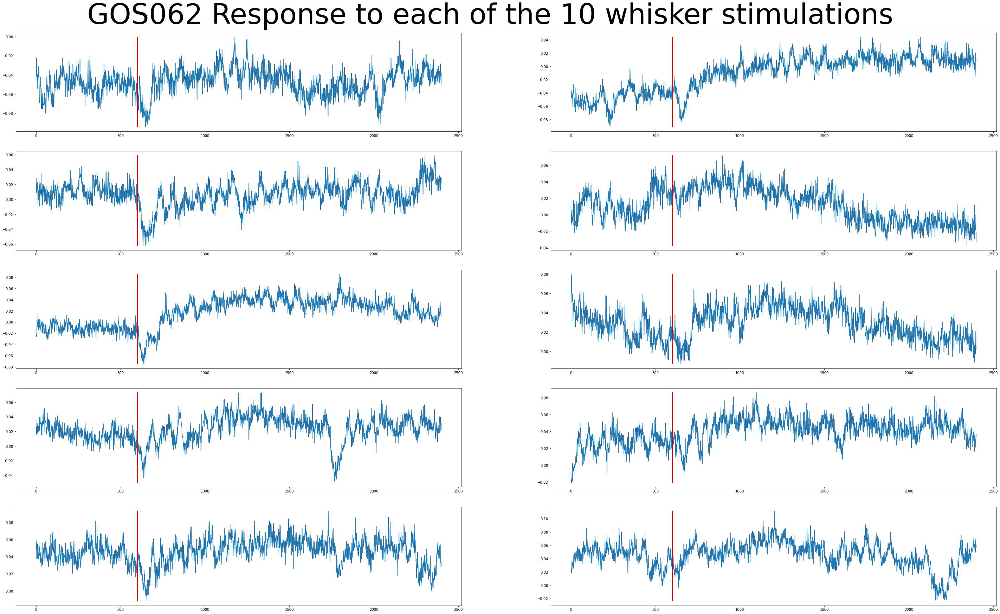

In [116]:
fig = plt.figure(figsize=(50,30)) #Plot whisker stim presentations's responses, one by one for first animal
for i in range(10):
    plt.subplot(5,2,i+1)
    plt.plot(stim_resp[i,:])
    plt.plot([601,601], [min(stim_resp[i,:]), max(stim_resp[i,:])], 'r-', lw=2)
fig.suptitle('GOS062 Response to each of the 10 whisker stimulations',fontsize=80, y=0.92); 

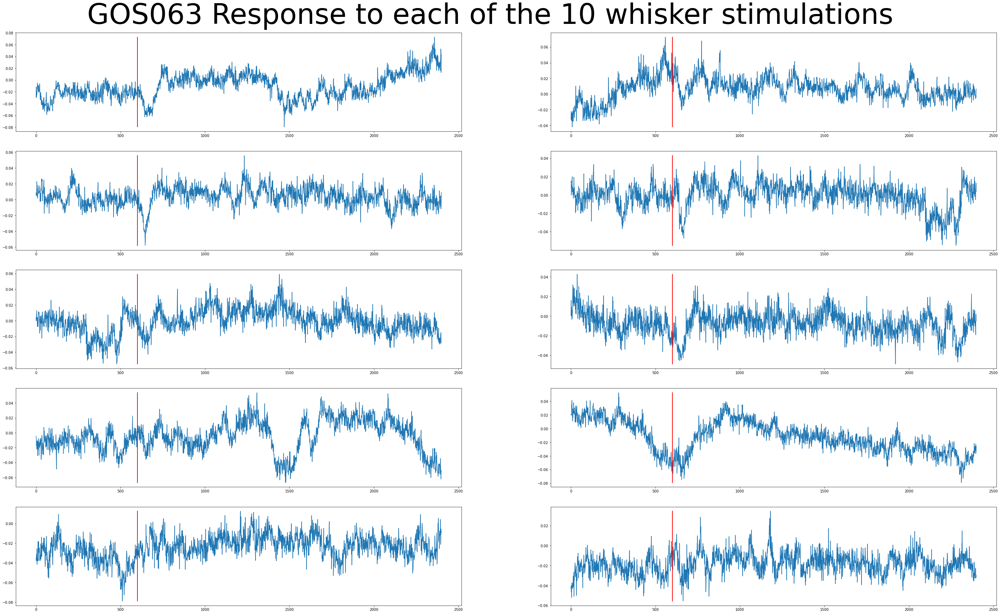

In [115]:
fig = plt.figure(figsize=(50,30))#Plot whisker stim presentations's responses one by one for second animal
for i in range(10):
    plt.subplot(5,2,i+1)
    plt.plot(stim_resp2[i,:])
    plt.plot([601,601], [min(stim_resp2[i,:]), max(stim_resp2[i,:])], 'r-', lw=2)
fig.suptitle('GOS063 Response to each of the 10 whisker stimulations',fontsize=80, y=0.92); 

In [13]:
#Array with responses surrounding (-20s +60s) the auditory stimuli presentations. I had to time-synch manually due to a problem with the time-locked speaker to generate loud sounds...
import random 
fr_rate = 30 #30 is a rough estimate of the frame rate so it might be worth it refining...
times = np.multiply([1500,1560,1620,1680,1740],fr_rate)
times2 = np.multiply([1526,1586,1646,1706,1766],fr_rate)
rnd = random.sample(range(0, len(dF_Fmean-1800)), 5) 
aud_resp = np.zeros([5,2400])
aud_resp2 = np.zeros([5,2400])
audcont_resp = np.zeros([5,2400])
for yy in range(len(times)):
   aud_resp[yy,:] = dF_Fmean[times[yy]-600:times[yy]+1800]
   aud_resp2[yy,:] = dF_Fmean2[times2[yy]-600:times2[yy]+1800]
   audcont_resp[yy,:] = dF_Fmean2[rnd[yy]-600:rnd[yy]+1800]

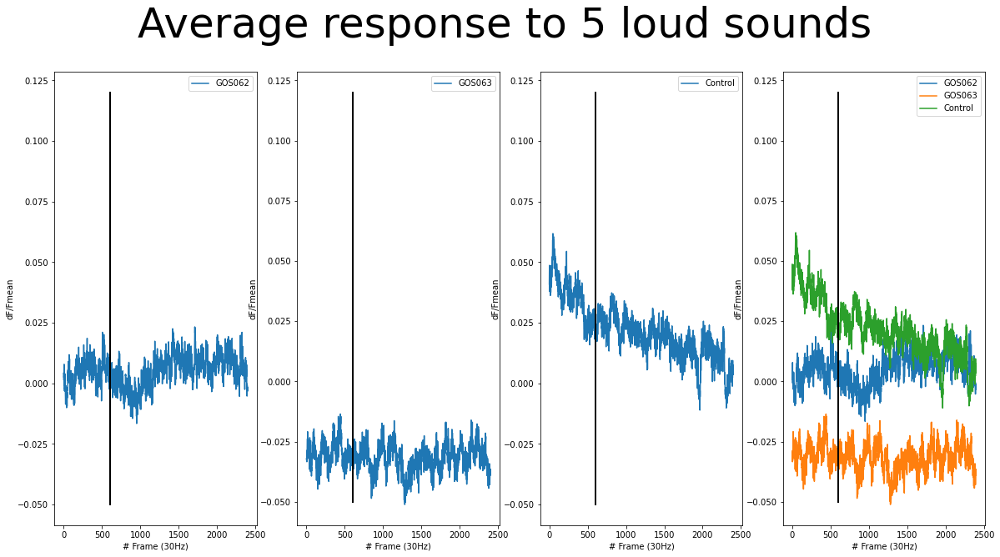

In [16]:
fig = plt.figure(figsize=(20,10)) #Plot average response to AUD presentations(AUDITORY STARTLE)
plt.subplot(1,4,1)
plt.plot(np.mean(aud_resp,0)) 
plt.plot([601,601], [-0.05, 0.12], 'k-', lw=2)
plt.xlabel('# Frame (30Hz)')
plt.ylabel('dF/Fmean')
plt.legend(['GOS062'])
plt.subplot(1,4,2)
plt.plot(np.mean(aud_resp2,0))
plt.plot([601,601], [-0.05, 0.12], 'k-', lw=2)
plt.xlabel('# Frame (30Hz)')
plt.ylabel('dF/Fmean')
plt.legend(['GOS063'])
plt.subplot(1,4,3)
plt.plot(np.mean(audcont_resp,0))
plt.plot([601,601], [-0.05, 0.12], 'k-', lw=2)
plt.xlabel('# Frame (30Hz)')
plt.ylabel('dF/Fmean')
plt.legend(['Control'])
plt.subplot(1,4,4)
plt.plot(np.mean(aud_resp,0))
plt.plot(np.mean(aud_resp2,0))
plt.plot(np.mean(audcont_resp,0))
plt.plot([601,601], [-0.05, 0.12], 'k-', lw=2)
plt.legend(['GOS062','GOS063','Control'])
plt.xlabel('# Frame (30Hz)')
plt.ylabel('dF/Fmean')
fig.suptitle('Average response to 5 loud sounds',fontsize=50, y=0.99); 

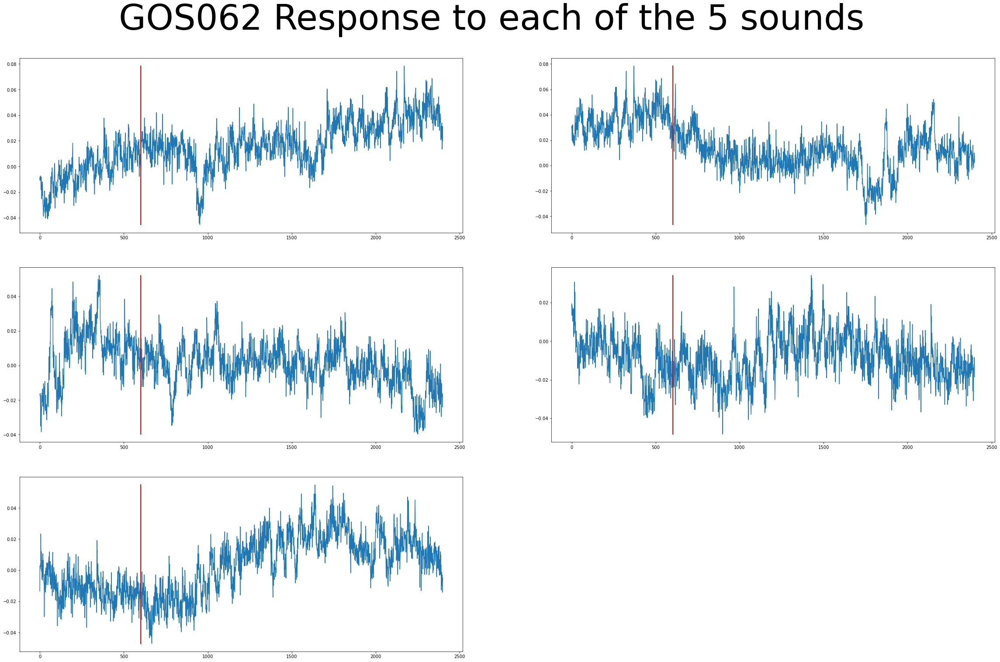

In [17]:
fig = plt.figure(figsize=(40,25))#Plot presentations one by one #First animal
for i in range(5):
    plt.subplot(3,2,i+1)
    plt.plot(aud_resp[i,:])
    plt.plot([601,601], [min(aud_resp[i,:]), max(aud_resp[i,:])], 'r-', lw=2)
fig.suptitle('GOS062 Response to each of the 5 sounds',fontsize=80, y=0.95); 

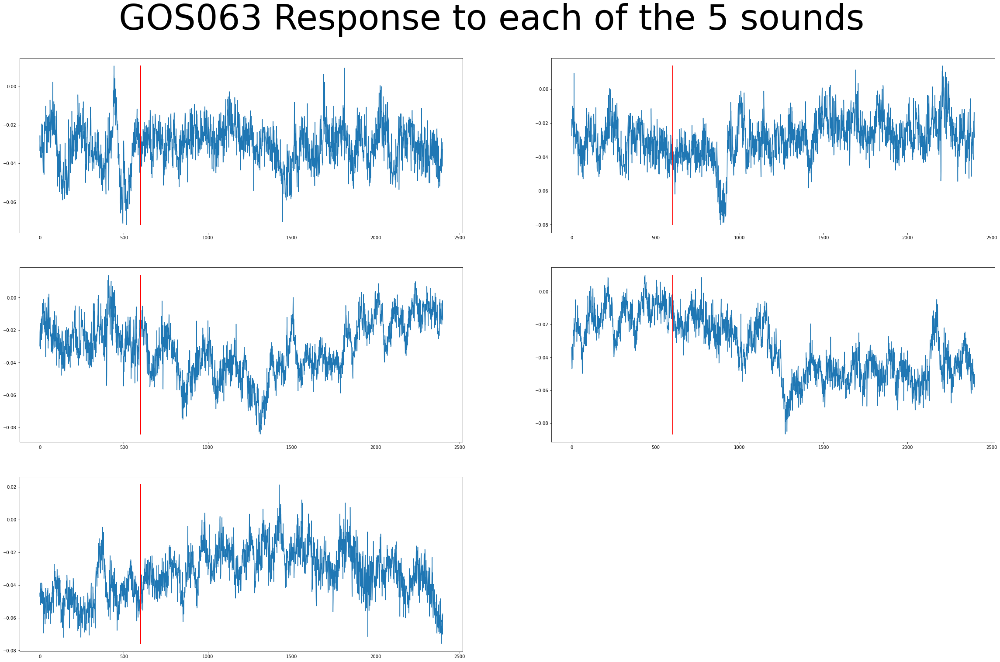

In [18]:
fig = plt.figure(figsize=(40,25))#Plot presentations one by one #Second Animal
for i in range(5):
    plt.subplot(3,2,i+1)
    plt.plot(aud_resp2[i,:])
    plt.plot([601,601], [min(aud_resp2[i,:]), max(aud_resp2[i,:])], 'r-', lw=2)
fig.suptitle('GOS063 Response to each of the 5 sounds',fontsize=80, y=0.95);    

# Analysis of 256 regions for GOS062 and GOS063

In [14]:
#Analysis by Regions (256, 16x16)
import numpy as np
import matplotlib.pyplot as plt
from numpy import genfromtxt
my_data = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS062_t_011_216regions_quantification.csv', delimiter=',')
my_data2 = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS063_t_001_216regions_quantification.csv', delimiter=',')
num_regions = 256
dF_F = np.zeros([num_regions,62496])
dF_F2 = np.zeros([num_regions,62496])
for i in range(num_regions):
    dF_F[i,:]  = (my_data[i*62496:(i+1)*62496,2]-np.mean(my_data[i*62496:(i+1)*62496,2]))/np.mean(my_data[i*62496:(i+1)*62496,2])
    dF_F2[i,:] = (my_data2[i*62496:(i+1)*62496,2]-np.mean(my_data2[i*62496:(i+1)*62496,2]))/np.mean(my_data2[i*62496:(i+1)*62496,2])



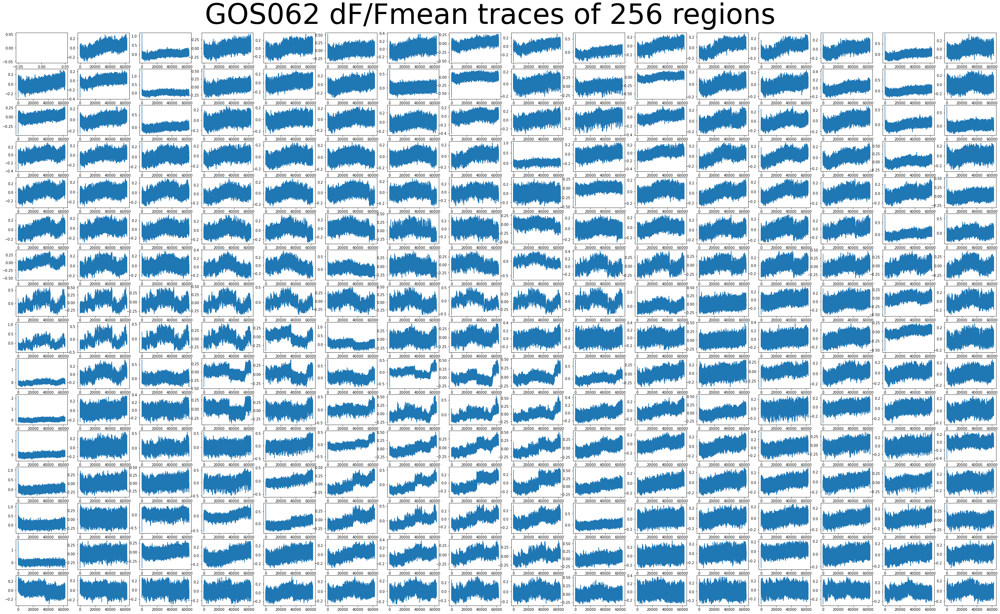

In [65]:
fig= plt.figure(figsize=(50,30)) #Plot traces of all regions for animal 1, spatially transposed, 1st row is 1st spatial column
for i in range(num_regions):
    plt.subplot(16,16,i+1)
    plt.plot(dF_F[i,:])
fig.suptitle('GOS062 dF/Fmean traces of 256 regions',fontsize=80,y=0.92);

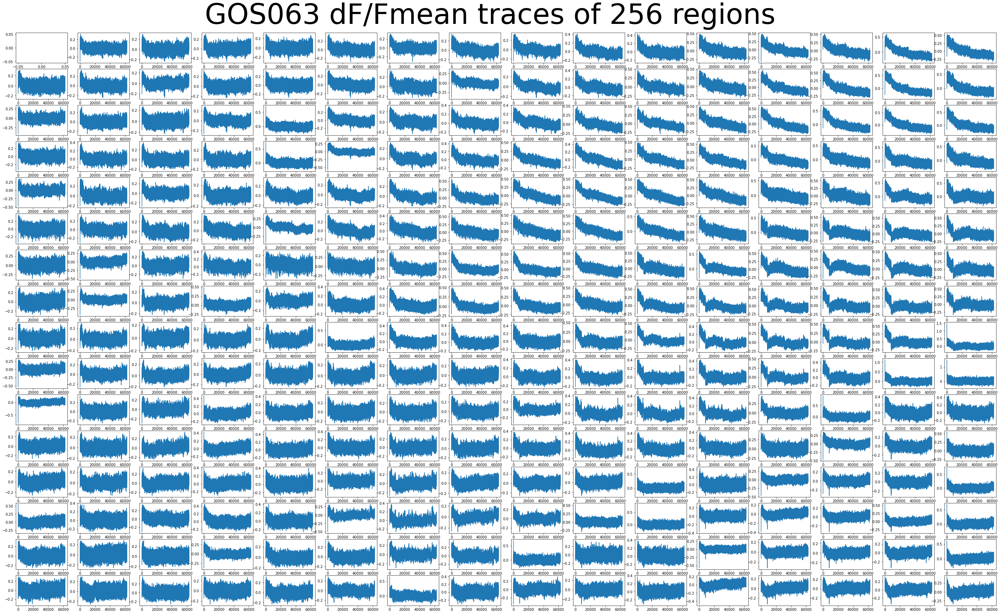

In [67]:
fig=plt.figure(figsize=(50,30)) #Plot traces of all regions for animal 2, spatially transposed, 1st row is 1st spatial column
for i in range(num_regions):
    plt.subplot(16,16,i+1)
    plt.plot(dF_F2[i,:])
fig.suptitle('GOS063 dF/Fmean traces of 256 regions',fontsize=80,y=0.92);

In [151]:
#Generates an array with peri-stimulus response -20s +60s assuming a frame rate of 30Hz for each region. Also generates a peri-random array as control.
import random
fws = np.array(frame_whisker_stim)
fws2 = np.array(frame_whisker_stim2)
rnd = random.sample(range(0, len(dF_F[0])), 10)
responses_stim = np.zeros([256,10,2400])
responses_stim2 = np.zeros([256,10,2400])
cont_resp = np.zeros([10,2400])
for ii in range(num_regions):
 for yy in range(len(fws)):
     responses_stim[ii,yy,:] = dF_F[ii,fws[yy]-600:fws[yy]+1800]
     responses_stim2[ii,yy,:] = dF_F2[ii,fws2[yy]-600:fws2[yy]+1800]
ii = 208    # Potential control but you would have to randomize ii
for jj in range(len(fws)):
     cont_resp[jj,:] = dF_F[ii,rnd[jj]-600:rnd[jj]+1800]

ValueError: could not broadcast input array from shape (1723,) into shape (2400,)

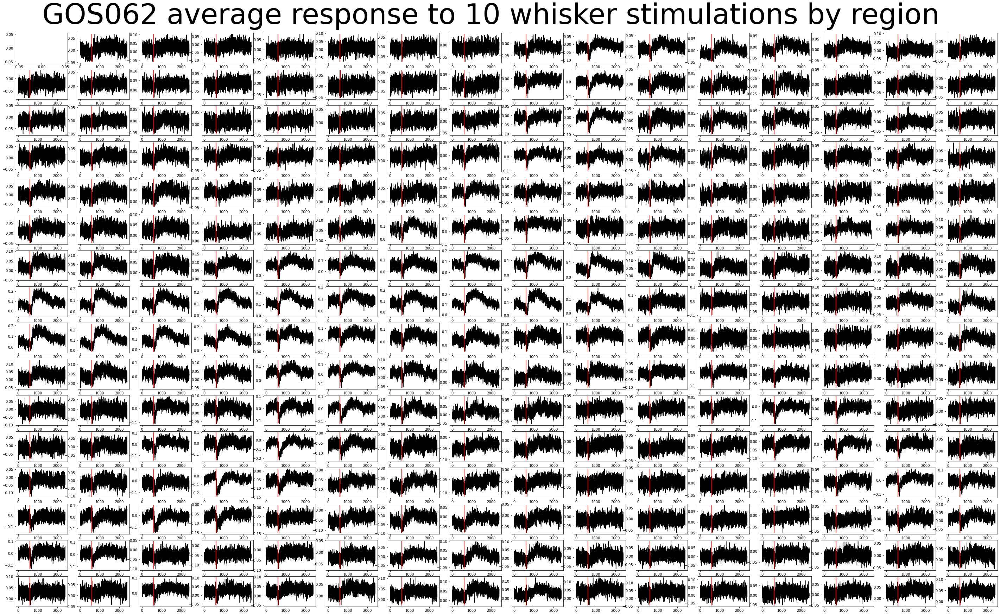

In [68]:
#Plots average response for each region of first animal to the 10 whisker stimulations. 
Av_resp = np.mean(responses_stim,1)
fig = plt.figure(figsize=(50,30)) #Plot traces of all regions for animal 1, spatially transposed, 1st row is 1st spatial column
for i in range(num_regions):
    plt.subplot(16,16,i+1)
    plt.plot(Av_resp[i,:],'k')   
    plt.plot([601,601], [min(Av_resp[i,:]), max(Av_resp[i,:])], 'r-', lw=2)
fig.suptitle('GOS062 average response to 10 whisker stimulations by region',fontsize=80,y=0.92);

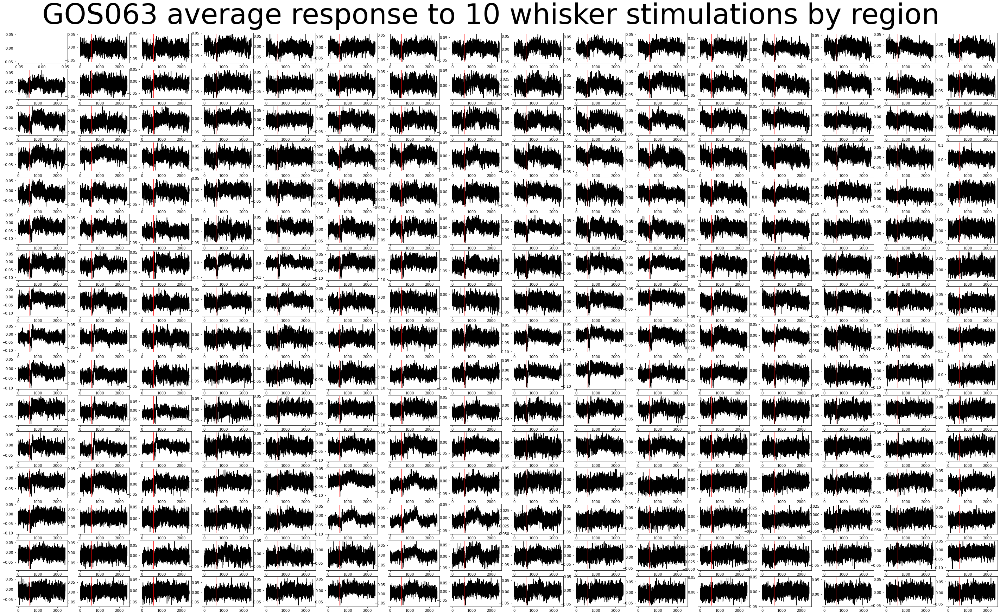

In [69]:
#Plots average response for each region of first animal to the 10 whisker stimulations. 
Av_resp2 = np.mean(responses_stim2,1)
fig = plt.figure(figsize=(50,30)) #Plot traces of all regions for animal 1, spatially transposed, 1st row is 1st spatial column
for i in range(num_regions):
    plt.subplot(16,16,i+1)
    plt.plot(Av_resp2[i,:],'k')    
    plt.plot([601,601], [min(Av_resp2[i,:]), max(Av_resp2[i,:])], 'r-', lw=2)
fig.suptitle('GOS063 average response to 10 whisker stimulations by region',fontsize=80,y=0.92);

## Trying to define a criteria for whisker responsiveness based on the shape

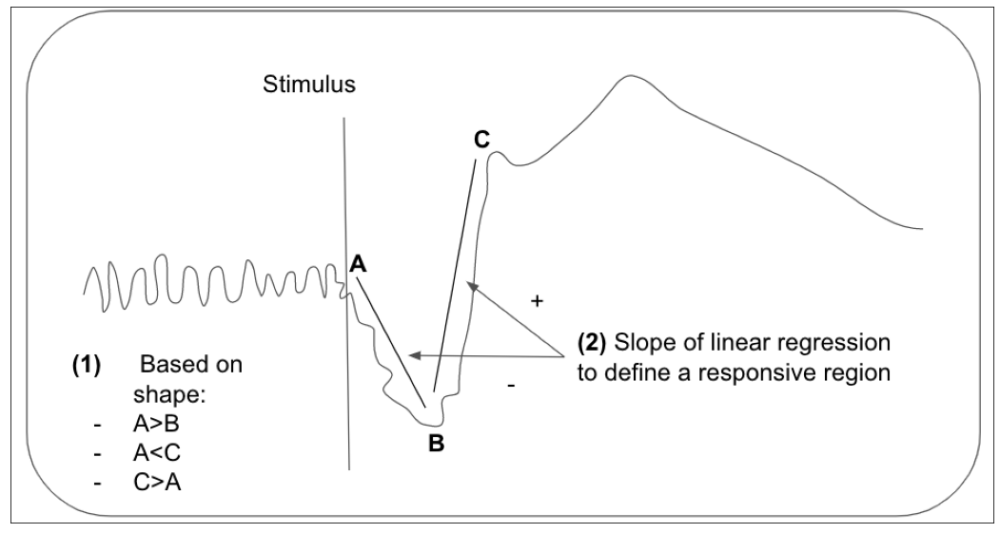

In [291]:
plt.figure(figsize=(50,10))
fig = plt.imshow(mpimg.imread('/Users/gabriel---/Desktop/Running_Data/Screenshot 2022-01-11 at 23.51.52.png'))
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)

In [184]:
#Approach to define area 'responsive' It didn't give great results...
from scipy.stats import linregress
Marker1 = np.zeros([256,1]) #5 Points before stim
Marker2 = np.zeros([256,1]) #5 Points at min
Marker3 = np.zeros([256,1]) #5 Points at max
Marker1_2 = np.zeros([256,1])
Marker2_2 = np.zeros([256,1])
Marker3_2 = np.zeros([256,1])
for i in range(num_regions):
 Marker1[i,0] = np.mean(Av_resp[i,590:600]) 
 Marker2[i,0] = np.mean(Av_resp[i,655:665])
 Marker3[i,0] = np.mean(Av_resp[i,715:725])
 Marker1_2[i,0] = np.mean(Av_resp2[i,590:600])
 Marker2_2[i,0] = np.mean(Av_resp2[i,655:665])
 Marker3_2[i,0] = np.mean(Av_resp2[i,715:725])

In [185]:
responsive_boolean = np.zeros([256,1])
responsive_boolean2 = np.zeros([256,1])
for i in range(num_regions):
    if Marker1[i,0]>Marker2[i,0] and Marker1[i,0]<Marker3[i,0] and Marker2[i,0]<Marker3[i,0]:
       responsive_boolean[i,0]=1
    if Marker1_2[i,0]>Marker2_2[i,0] and Marker1_2[i,0]<Marker3_2[i,0] and Marker2_2[i,0]<Marker3_2[i,0]:
       responsive_boolean2[i,0]=1

In [286]:
#Another approach to define responsive regions... still not perfect
from scipy.stats import linregress
neg_slope_thrs = -0.00001
pos_slope_thrs = 0.0001
#linreg_thrs =  #temp
x_val = np.array(range(0,60))
temp = np.zeros([256,5])
temp2 = np.zeros([256,5])
tomp = np.zeros([256,5])
tomp2 = np.zeros([256,5])
responsive_boolean = np.zeros([256,1])
responsive_boolean2 = np.zeros([256,1])
for i in range(num_regions):
  temp[i,:] = linregress(x_val, Av_resp[i,601:661])
  tomp[i,:] = linregress(x_val, Av_resp[i,661:721])
  temp2[i,:] = linregress(x_val, Av_resp2[i,601:661])
  tomp2[i,:] = linregress(x_val, Av_resp2[i,661:721])
  if temp[i,0] < neg_slope_thrs and tomp[i,0] > pos_slope_thrs:
      responsive_boolean[i,0]=1
  if temp2[i,0] < neg_slope_thrs and tomp2[i,0] > pos_slope_thrs:
      responsive_boolean2[i,0]=1

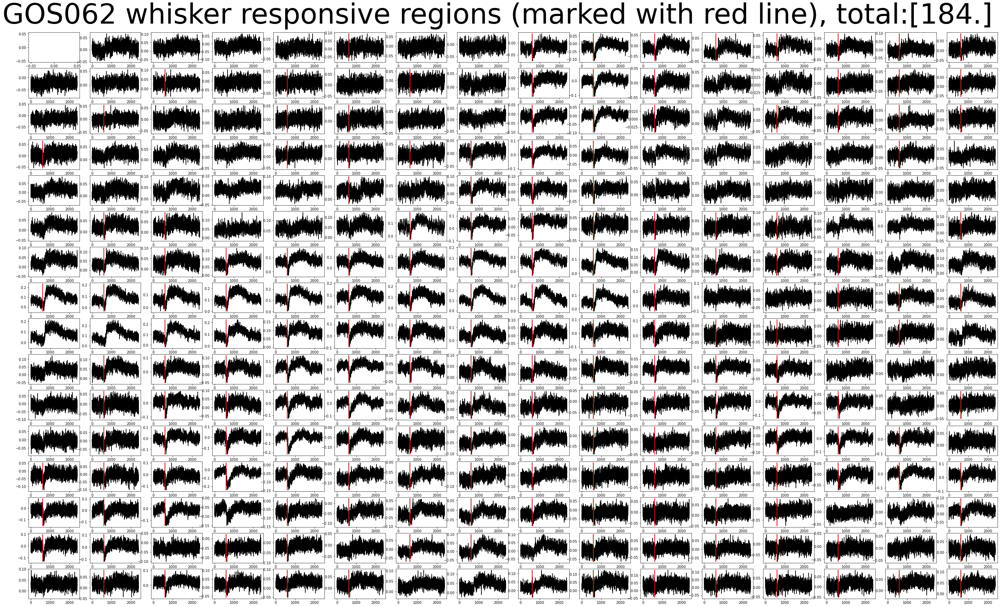

In [289]:
#Plots average response for each region of first animal to the 10 whisker stimulations. 
Av_resp = np.mean(responses_stim,1)
fig = plt.figure(figsize=(50,30)) #Plot traces of all regions for animal 1, spatially transposed, 1st row is 1st spatial column
total = sum(responsive_boolean)
title = 'GOS062 whisker responsive regions (marked with red line), total:'+str(total)
for i in range(num_regions):
    plt.subplot(16,16,i+1)
    plt.plot(Av_resp[i,:],'k')   
    #plt.plot([601,601], [min(Av_resp[i,:]), max(Av_resp[i,:])], 'r-', lw=2)
    if responsive_boolean[i,0]==1:
        plt.plot([601,601], [min(Av_resp[i,:]), max(Av_resp[i,:])], 'r-', lw=2)
fig.suptitle(title,fontsize=80,y=0.92);

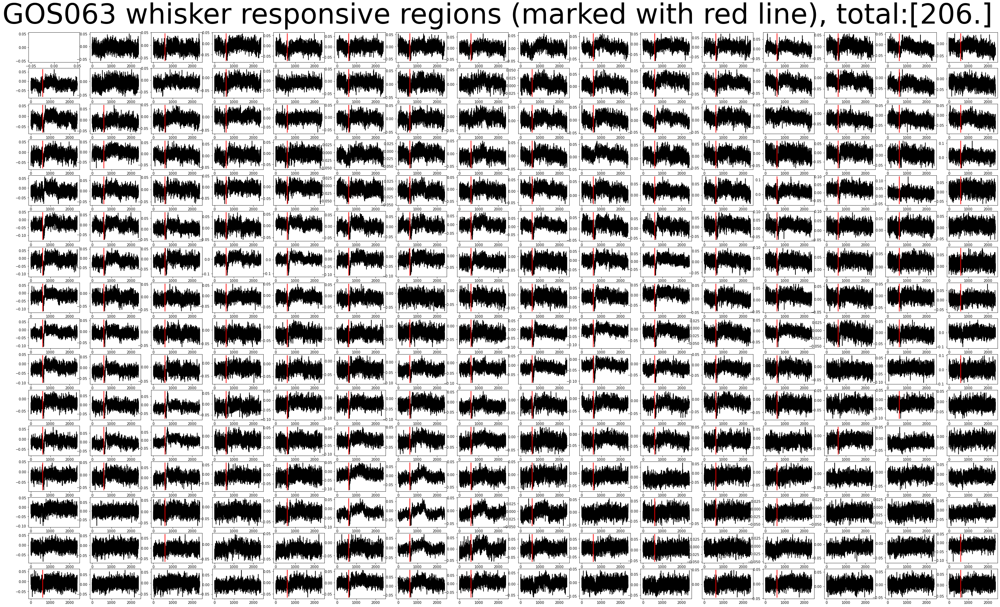

In [290]:
#Plots average response for each region of first animal to the 10 whisker stimulations. 
Av_resp2 = np.mean(responses_stim2,1)
fig = plt.figure(figsize=(50,30))#Plot traces of all regions for animal 1, spatially transposed, 1st row is 1st spatial column
total = sum(responsive_boolean2)
title = 'GOS063 whisker responsive regions (marked with red line), total:'+str(total)
for i in range(num_regions):
    plt.subplot(16,16,i+1)
    plt.plot(Av_resp2[i,:],'k')   
    #plt.plot([601,601], [min(Av_resp[i,:]), max(Av_resp[i,:])], 'r-', lw=2)
    if responsive_boolean2[i,0]==1:
        plt.plot([601,601], [min(Av_resp2[i,:]), max(Av_resp2[i,:])], 'r-', lw=2)
fig.suptitle(title,fontsize=80,y=0.92);

# Adding Behavioural correlates data: Pupil and Whisker/Nose

In [2]:
#
import numpy as np
import matplotlib.pyplot as plt
from numpy import genfromtxt
WN1 = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS062_t_001DLC_resnet50_WhiskAndNoseJan18shuffle1_500000.csv', delimiter=',')
Pup1 = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS062_t_001DLC_resnet152_Updated 5 Dot Training ModelNov21shuffle1_1030000.csv', delimiter=',')
WN2 = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS063_t_001DLC_resnet50_WhiskAndNoseJan18shuffle1_500000.csv', delimiter=',')
Pup2 = genfromtxt('/Users/gabriel---/Desktop/Running_Data/2021_12_11_GOS063_t_001DLC_resnet152_Updated 5 Dot Training ModelNov21shuffle1_1030000.csv', delimiter=',')
#dF_Fmean = (my_data[1:62497,2]-np.mean(my_data[1:62497,2]))/np.mean(my_data[1:62497,2])
#dF_Fmean2 = (my_data2[1:62497,2]-np.mean(my_data2[1:62497,2]))/np.mean(my_data2[1:62497,2])
#fig = plt.figure(figsize=(30,20)) 
#plt.plot(dF_Fmean)
#plt.plot(dF_Fmean2)
#plt.plot([18000,18000], [-0.2, 0.3], 'k-', lw=2)
#x0 = 18000
#for i in range(10):
#   plt.plot([x0,x0], [-0.2, 0.3], 'k-', lw=2)
#   x0+=1800
#plt.plot([45000,45000], [-0.2, 0.3], 'k-', lw=2)
#plt.plot([54000,54000], [-0.2, 0.3], 'k-', lw=2)
#plt.legend(['GOS062','GOS063'], prop={'size': 20})
#plt.xlabel('# Frame (30Hz)',fontsize=35)
#plt.ylabel('dF/Fmean',fontsize=35)
#fig.suptitle('GOS062-3 dF/Fmean trace across session',fontsize=50, y=0.91); 
#plt.show()

In [3]:
#from scipy.spatial import distance --> Another way to estimate eucclidean distance but slower
Nose_move = np.zeros([len(WN1)-4,1])
Whisker1_move = np.zeros([len(WN1)-4,1])
Whisker2_move = np.zeros([len(WN1)-4,1])
for i in range(3,len(WN1)-1):
    Nose_move[i-3,0] = np.array(np.linalg.norm(WN1[i,1:2]-WN1[i+1,1:2]))
    Whisker1_move[i-3,0] = np.array(np.linalg.norm(WN1[i,4:5]-WN1[i+1,4:5]))
    Whisker2_move[i-3,0] = np.array(np.linalg.norm(WN1[i,7:8]-WN1[i+1,7:8]))
Nose_move2 = np.zeros([len(WN2)-4,1])
Whisker1_move2 = np.zeros([len(WN2)-4,1])
Whisker2_move2 = np.zeros([len(WN2)-4,1])
for i in range(3,len(WN2)-1):
    Nose_move2[i-3,0] = np.array(np.linalg.norm(WN2[i,1:2]-WN2[i+1,1:2]))
    Whisker1_move2[i-3,0] = np.array(np.linalg.norm(WN2[i,4:5]-WN2[i+1,4:5]))
    Whisker2_move2[i-3,0] = np.array(np.linalg.norm(WN2[i,7:8]-WN2[i+1,7:8]))

(-0.5, 20.0)

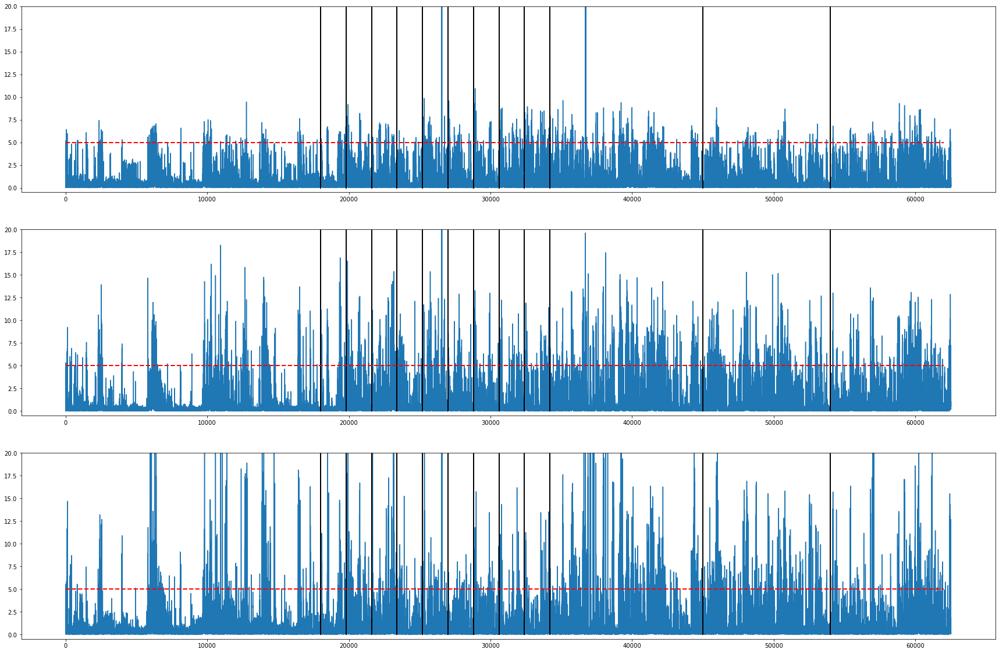

In [13]:
#Plot overall trace of pupil and whisker with approximate Whisker Stim and Sound presentations MOUSE 1
plt.figure(figsize=(30,20)) 
plt.subplot(3,1,1)
plt.plot(Nose_move)
x0 = 18000
for i in range(10):
   plt.plot([x0,x0], [0, 350], 'k-', lw=2)
   x0+=1800
plt.plot([45000,45000], [0, 350], 'k-', lw=2)
plt.plot([54000,54000], [0, 350], 'k-', lw=2)
plt.plot([0,62000], [5, 5], 'r--', lw=2)
plt.ylim([-0.5,20]) #There are some HUGE outliers, real or not?
plt.subplot(3,1,2)
plt.plot(Whisker1_move)
x0 = 18000
for i in range(10):
   plt.plot([x0,x0], [0, 20], 'k-', lw=2)
   x0+=1800
plt.plot([45000,45000], [0, 20], 'k-', lw=2)
plt.plot([54000,54000], [0, 20], 'k-', lw=2)
plt.plot([0,62000], [5, 5], 'r--', lw=2)
plt.ylim([-0.5,20]) #There are some HUGE outliers, real or not?
plt.subplot(3,1,3)
plt.plot(Whisker2_move)
x0 = 18000
for i in range(10):
   plt.plot([x0,x0], [0, 20], 'k-', lw=2)
   x0+=1800
plt.plot([45000,45000], [0, 20], 'k-', lw=2)
plt.plot([54000,54000], [0, 20], 'k-', lw=2)
plt.plot([0,62000], [5, 5], 'r--', lw=2)
plt.ylim([-0.5,20]) #There are some HUGE outliers, real or not?

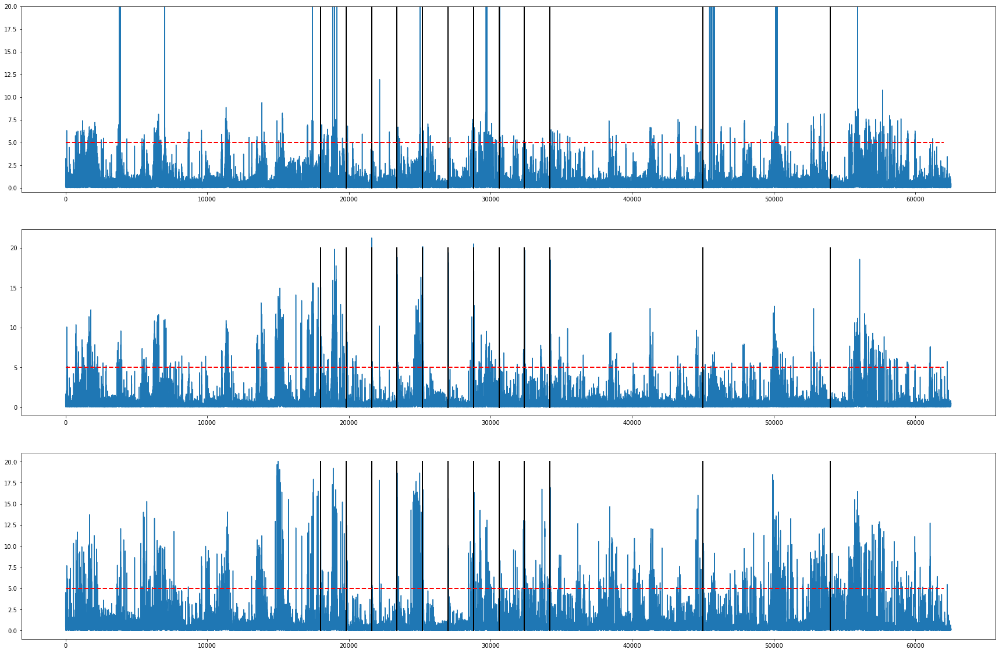

In [12]:
#Plot overall trace of pupil and whisker with approximate Whisker Stim and Sound presentations MOUSE 2
plt.figure(figsize=(30,20)) 
plt.subplot(3,1,1)
plt.plot(Nose_move2)
x0 = 18000
for i in range(10):
   plt.plot([x0,x0], [0, 350], 'k-', lw=2)
   x0+=1800
plt.plot([45000,45000], [0, 350], 'k-', lw=2)
plt.plot([54000,54000], [0, 350], 'k-', lw=2)
plt.plot([0,62000], [5, 5], 'r--', lw=2)
plt.ylim([-0.5,20]) #There are some HUGE outliers, real or not?
plt.subplot(3,1,2)
plt.plot(Whisker1_move2)
x0 = 18000
for i in range(10):
   plt.plot([x0,x0], [0, 20], 'k-', lw=2)
   x0+=1800
plt.plot([45000,45000], [0, 20], 'k-', lw=2)
plt.plot([54000,54000], [0, 20], 'k-', lw=2)
plt.plot([0,62000], [5, 5], 'r--', lw=2)
plt.subplot(3,1,3)
plt.plot(Whisker2_move2)
x0 = 18000
for i in range(10):
   plt.plot([x0,x0], [0, 20], 'k-', lw=2)
   x0+=1800
plt.plot([45000,45000], [0, 20], 'k-', lw=2)
plt.plot([54000,54000], [0, 20], 'k-', lw=2)
plt.plot([0,62000], [5, 5], 'r--', lw=2)

## Two important parameters to consider for peri-movement:

 - Movement threshold (e.g. 5)
 - Prior movement descrimination (e.g. 10 frames)

In [71]:
#Extracting peri-movement global serotonergic response response
acti_nose = np.empty([len(Nose_move),2400])
acti_nose[:] = np.nan
acti_whisker1 = np.empty([len(Nose_move),2400])
acti_whisker1[:]= np.nan
acti_whisker2 = np.empty([len(Nose_move),2400])
acti_whisker2[:]= np.nan
for ii in range(0,len(Nose_move)-1900):
    if Nose_move[ii,0]>5 and ii>600 and ii<(len(Nose_move)-1800) and (Nose_move[ii-10:ii,0]<5).all():
       acti_nose[ii,:] = dF_Fmean[ii-600:ii+1800]
    if Whisker1_move[ii,0]>5 and ii>600 and ii<(len(Whisker1_move)-1800) and (Whisker1_move[ii-10:ii,0]<5).all():
       acti_whisker1[ii,:] = dF_Fmean[ii-600:ii+1800]
    if Whisker2_move[ii,0]>5 and ii>600 and ii<(len(Whisker2_move)-1800) and (Whisker2_move[ii-10:ii,0]<5).all():
       acti_whisker2[ii,:] = dF_Fmean[ii-600:ii+1800]

In [72]:
#Extracting peri-movement global serotonergic response response
acti_nose_2 = np.empty([len(Nose_move2),2400])
acti_nose_2 [:] = np.nan
acti_whisker1_2 = np.empty([len(Nose_move2),2400])
acti_whisker1_2[:]= np.nan
acti_whisker2_2 = np.empty([len(Nose_move2),2400])
acti_whisker2_2[:]= np.nan
for ii in range(0,len(Nose_move)-1900):
    if Nose_move2[ii,0]>5 and ii>600 and ii<(len(Nose_move2)-1800) and (Nose_move2[ii-10:ii,0]<5).all():
       acti_nose_2[ii,:] = dF_Fmean2[ii-600:ii+1800]
    if Whisker1_move2[ii,0]>5 and ii>600 and ii<(len(Whisker1_move2)-1800) and (Whisker1_move2[ii-10:ii,0]<5).all():
       acti_whisker1_2[ii,:] = dF_Fmean2[ii-600:ii+1800]
    if Whisker2_move2[ii,0]>5 and ii>600 and ii<(len(Whisker2_move2)-1800) and (Whisker2_move2[ii-10:ii,0]<5).all():
       acti_whisker2_2[ii,:] = dF_Fmean2[ii-600:ii+1800]

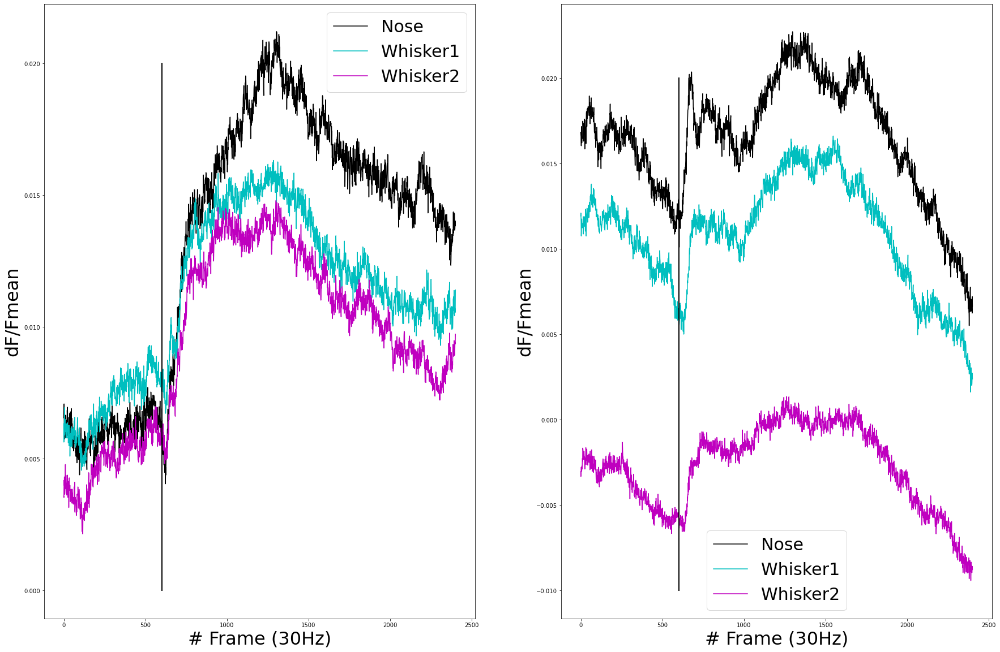

In [68]:
#Serotonergic activity peri-nose (black0) or peri-whisker(blue-red) movement
plt.figure(figsize=(30,20)) 
plt.subplot(1,2,1)
plt.plot(np.nanmean(acti_nose[:],0),'k')
plt.plot(np.nanmean(acti_whisker1[:],0),'c')
plt.plot(np.nanmean(acti_whisker2[:],0),'m')
plt.plot([600,600], [-0.0,0.02], 'k-', lw=2)
plt.legend(['Nose','Whisker1','Whisker2'], prop={'size': 30})
plt.xlabel('# Frame (30Hz)',fontsize=32)
plt.ylabel('dF/Fmean',fontsize=32);
plt.subplot(1,2,2)
plt.plot(np.nanmean(acti_nose_2[:],0),'k')
plt.plot(np.nanmean(acti_whisker1_2[:],0),'c')
plt.plot(np.nanmean(acti_whisker2_2[:],0),'m')
plt.plot([600,600], [-0.01,0.02], 'k-', lw=2)
plt.legend(['Nose','Whisker1','Whisker2'], prop={'size': 30})
plt.xlabel('# Frame (30Hz)',fontsize=32)
plt.ylabel('dF/Fmean',fontsize=32);


This code shows intuitively the values that I'm removing:
plt.subplot(1,2,1)
plt.plot(acti_nose)
plt.subplot(1,2,2)
plt.plot(ANwoSTIM)

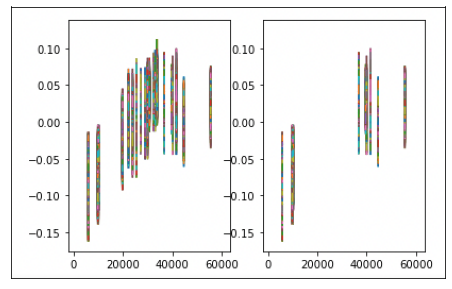

In [61]:
import matplotlib.image as mpimg
plt.figure(figsize=(20,5))
fig = plt.imshow(mpimg.imread('/Users/gabriel---/Desktop/Running_Data/Screenshot 2022-01-21 at 14.07.28.png'))
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)

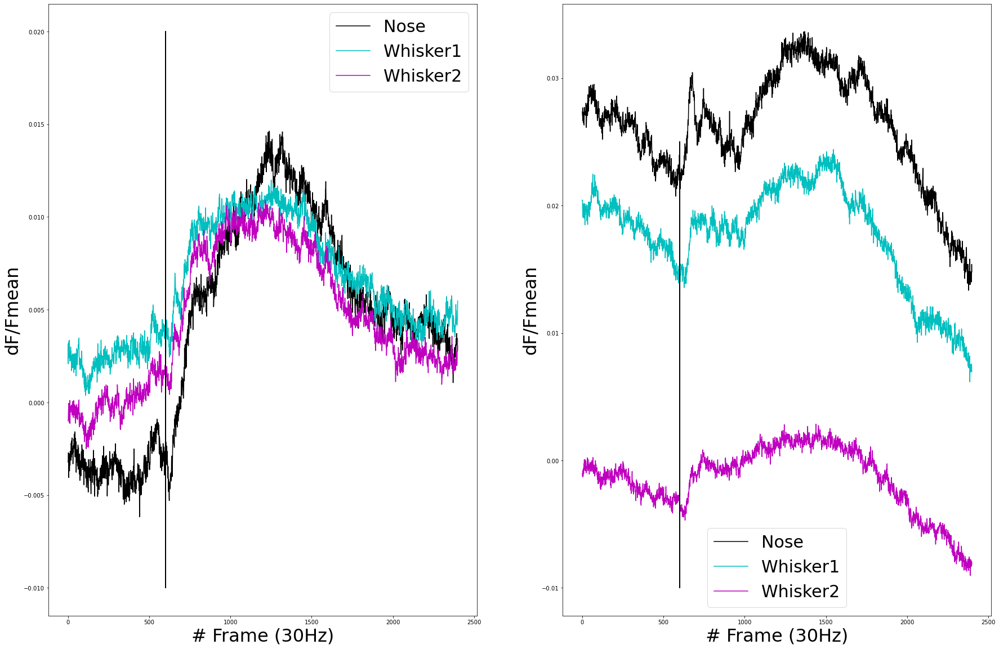

In [69]:
#Serotonergic activity peri-nose (black) or peri-whisker(blue-red) movement WITHOUT stim trials
ANwoSTIM = acti_nose[:]
ANwoSTIM[18000:36000,:]=np.nan #CAREFUL THIS IS ALSO zeroing acti_nose! So YOU have to rerun the acti_nose code... SAME for the others, I haven't sorted it out yet!
AW1woSTIM = acti_whisker1[:]
AW1woSTIM[18000:36000,:]=np.nan
AW2woSTIM = acti_whisker2[:]
AW2woSTIM[18000:36000,:]=np.nan
plt.figure(figsize=(30,20)) 
plt.subplot(1,2,1)
plt.plot(np.nanmean(ANwoSTIM[:],0),'k')
plt.plot(np.nanmean(AW1woSTIM[:],0),'c')
plt.plot(np.nanmean(AW2woSTIM[:],0),'m')
plt.plot([600,600], [-0.01,0.02], 'k-', lw=2)
plt.legend(['Nose','Whisker1','Whisker2'], prop={'size': 30})
plt.xlabel('# Frame (30Hz)',fontsize=32)
plt.ylabel('dF/Fmean',fontsize=32);
ANwoSTIM2 = acti_nose_2[:]
ANwoSTIM2[18000:36000,:]=np.nan
AW1woSTIM2 = acti_whisker1_2[:]
AW1woSTIM2[18000:36000,:]=np.nan
AW2woSTIM2 = acti_whisker2_2[:]
AW2woSTIM2[18000:36000,:]=np.nan
plt.subplot(1,2,2)
plt.plot(np.nanmean(ANwoSTIM2[:],0),'k')
plt.plot(np.nanmean(AW1woSTIM2[:],0),'c')
plt.plot(np.nanmean(AW2woSTIM2[:],0),'m')
plt.plot([600,600], [-0.01,0.025], 'k-', lw=2)
plt.legend(['Nose','Whisker1','Whisker2'], prop={'size': 30})
plt.xlabel('# Frame (30Hz)',fontsize=32)
plt.ylabel('dF/Fmean',fontsize=32);

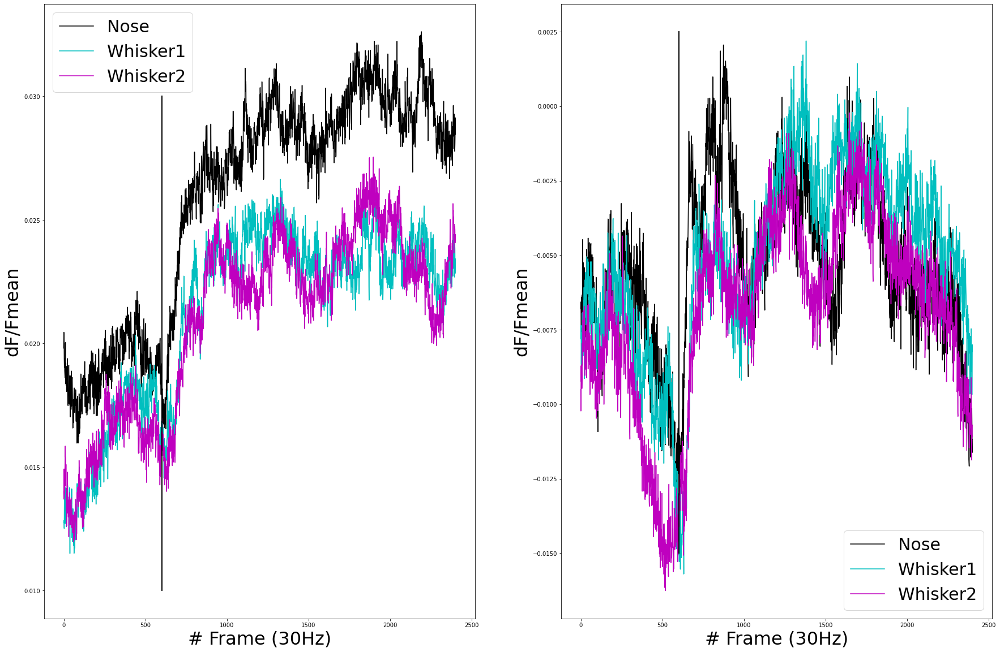

In [73]:
plt.figure(figsize=(30,20)) 
plt.subplot(1,2,1)
plt.plot(np.nanmean(acti_nose[18000:36000],0),'k')
plt.plot(np.nanmean(acti_whisker1[18000:36000],0),'c')
plt.plot(np.nanmean(acti_whisker2[18000:36000],0),'m')
plt.plot([600,600], [0.01,0.03], 'k-', lw=2)
plt.legend(['Nose','Whisker1','Whisker2'], prop={'size': 30})
plt.xlabel('# Frame (30Hz)',fontsize=32)
plt.ylabel('dF/Fmean',fontsize=32);
plt.subplot(1,2,2)
plt.plot(np.nanmean(acti_nose_2[18000:36000],0),'k')
plt.plot(np.nanmean(acti_whisker1_2[18000:36000],0),'c')
plt.plot(np.nanmean(acti_whisker2_2[18000:36000],0),'m')
plt.plot([600,600], [-0.015,0.0025], 'k-', lw=2)
plt.legend(['Nose','Whisker1','Whisker2'], prop={'size': 30})
plt.xlabel('# Frame (30Hz)',fontsize=32)
plt.ylabel('dF/Fmean',fontsize=32);

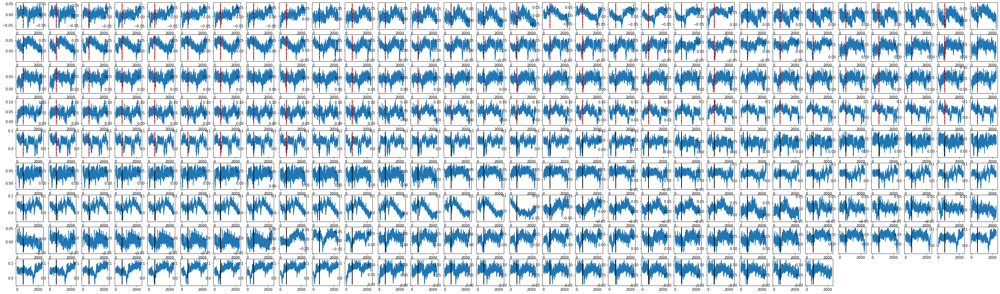

In [74]:
plt.figure(figsize=(50,50))
count=1
for iii in range(len(acti_nose[:,0])):
    if acti_nose[iii,0] >0:
        plt.subplot(30,30,count)
        plt.plot(acti_nose[iii,:])
        count+=1
        plt.plot([600,600], [min(acti_nose[iii,:]),max(acti_nose[iii,:])], 'k-', lw=2)
        if iii>18000 and iii<36000:
            plt.plot([600,600], [min(acti_nose[iii,:]),max(acti_nose[iii,:])], 'r--', lw=2)
    if count ==900:
        break
 

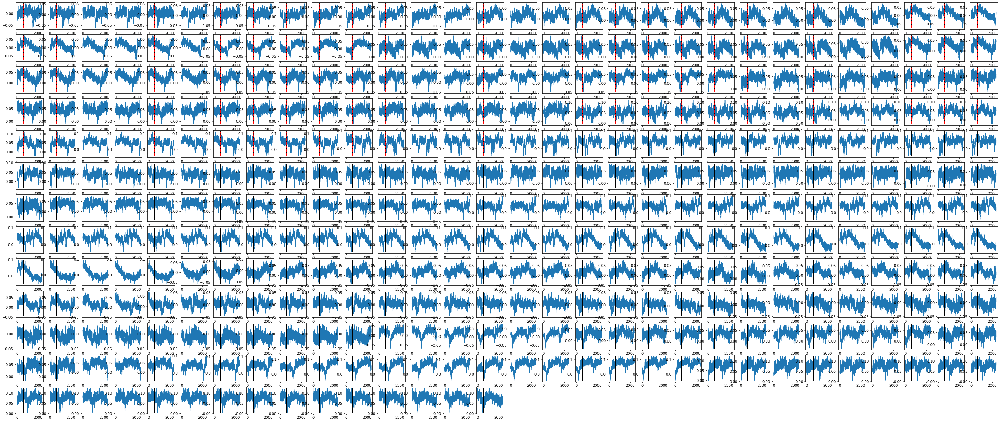

In [55]:
plt.figure(figsize=(50,50))
count=1
for iii in range(len(acti_whisker1[:,0])):
    if acti_whisker1[iii,0] >0:
        plt.subplot(30,30,count)
        plt.plot(acti_whisker1[iii,:])
        count+=1
        plt.plot([600,600], [min(acti_whisker1[iii,:]),max(acti_whisker1[iii,:])], 'k-', lw=2)
        if iii>18000 and iii<36000:
            plt.plot([600,600], [min(acti_whisker1[iii,:]),max(acti_whisker1[iii,:])], 'r--', lw=2)
    if count ==900:
        break

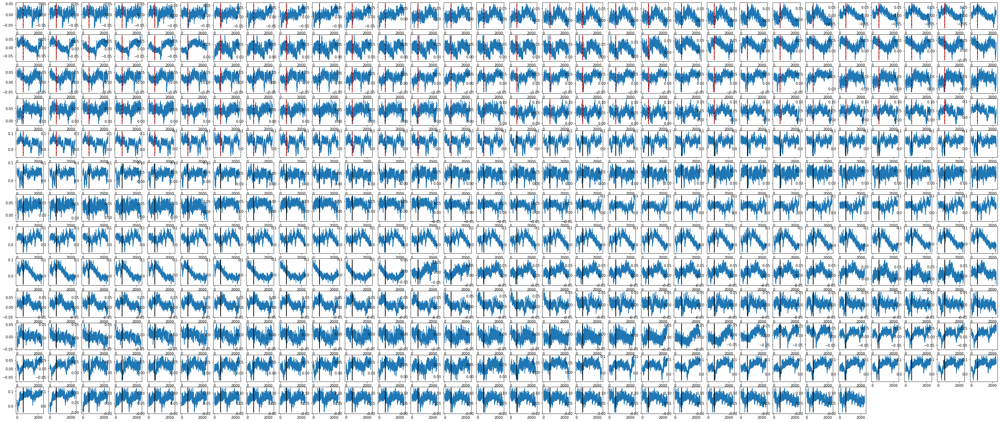

In [56]:
plt.figure(figsize=(50,50))
count=1
for iii in range(len(acti_whisker2[:,0])):
    if acti_whisker2[iii,0] >0:
        plt.subplot(30,30,count)
        plt.plot(acti_whisker2[iii,:])
        count+=1
        plt.plot([600,600], [min(acti_whisker2[iii,:]),max(acti_whisker2[iii,:])], 'k-', lw=2)
        if iii>18000 and iii<36000:
            plt.plot([600,600], [min(acti_whisker2[iii,:]),max(acti_whisker2[iii,:])], 'r--', lw=2)
    if count ==900:
        break

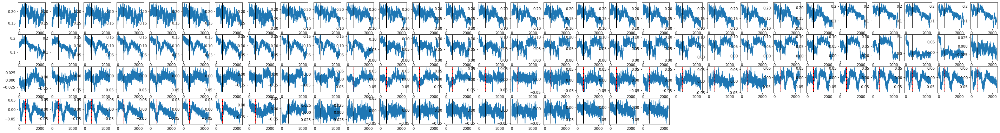

In [58]:
plt.figure(figsize=(50,50))
count=1
for iii in range(len(acti_nose_2[:,0])):
    if acti_nose_2[iii,0] >0:
        plt.subplot(30,30,count)
        plt.plot(acti_nose_2[iii,:])
        count+=1
        plt.plot([600,600], [min(acti_nose_2[iii,:]),max(acti_nose_2[iii,:])], 'k-', lw=2)
        if iii>18000 and iii<36000:
            plt.plot([600,600], [min(acti_nose_2[iii,:]),max(acti_nose_2[iii,:])], 'r--', lw=2)
    if count ==900:
        break

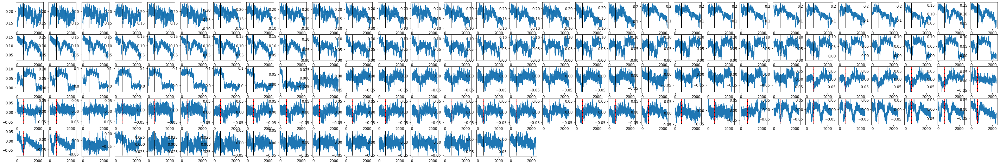

In [60]:
plt.figure(figsize=(50,50))
count=1
for iii in range(len(acti_whisker1_2[:,0])):
    if acti_whisker1_2[iii,0] >0:
        plt.subplot(30,30,count)
        plt.plot(acti_whisker1_2[iii,:])
        count+=1
        plt.plot([600,600], [min(acti_whisker1_2[iii,:]),max(acti_whisker1_2[iii,:])], 'k-', lw=2)
        if iii>18000 and iii<36000:
            plt.plot([600,600], [min(acti_whisker1_2[iii,:]),max(acti_whisker1_2[iii,:])], 'r--', lw=2)
    if count ==900:
        break

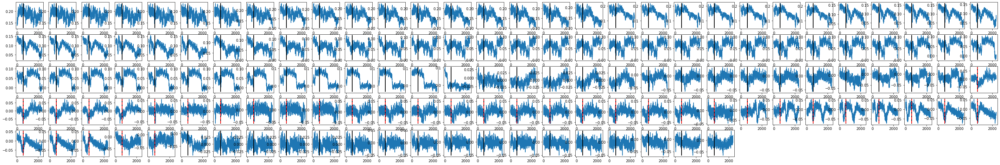

In [59]:
plt.figure(figsize=(50,50))
count=1
for iii in range(len(acti_whisker2_2[:,0])):
    if acti_whisker2_2[iii,0] >0:
        plt.subplot(30,30,count)
        plt.plot(acti_whisker2_2[iii,:])
        count+=1
        plt.plot([600,600], [min(acti_whisker2_2[iii,:]),max(acti_whisker2_2[iii,:])], 'k-', lw=2)
        if iii>18000 and iii<36000:
            plt.plot([600,600], [min(acti_whisker2_2[iii,:]),max(acti_whisker2_2[iii,:])], 'r--', lw=2)
    if count ==900:
        break

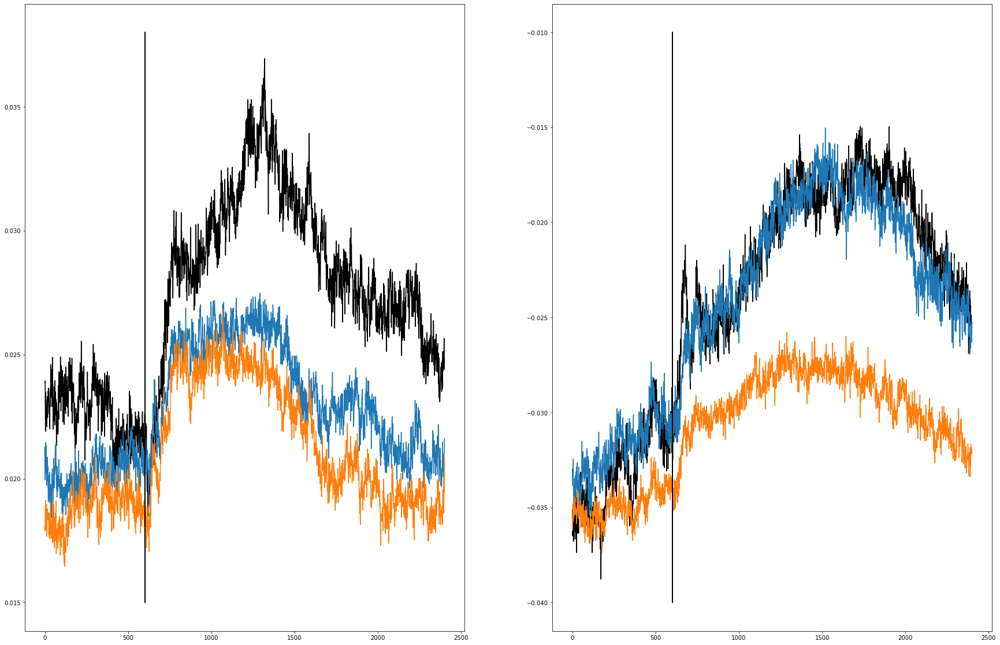

In [84]:
plt.figure(figsize=(30,20))
plt.subplot(1,2,1)
plt.plot(np.nanmean(acti_nose[38000:60000,:],0),'k')
plt.plot(np.nanmean(acti_whisker1[38000:60000,:],0))
plt.plot(np.nanmean(acti_whisker2[38000:60000,:],0))
plt.plot([600,600], [0.015,0.038], 'k-', lw=2)
plt.subplot(1,2,2)
plt.plot(np.nanmean(acti_nose_2[38000:60000,:],0),'k')
plt.plot(np.nanmean(acti_whisker1_2[38000:60000,:],0))
plt.plot(np.nanmean(acti_whisker2_2[38000:60000,:],0))
plt.plot([600,600], [-0.04,-0.01], 'k-', lw=2)

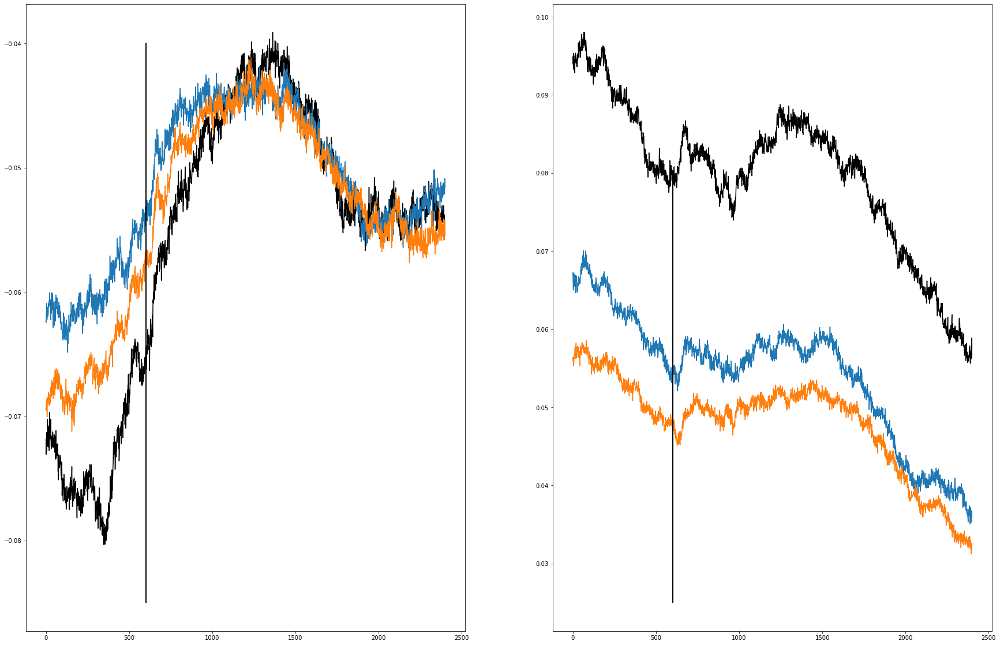

In [85]:
plt.figure(figsize=(30,20))
plt.subplot(1,2,1)
plt.plot(np.nanmean(acti_nose[0:18000,:],0),'k')
plt.plot(np.nanmean(acti_whisker1[0:18000,:],0))
plt.plot(np.nanmean(acti_whisker2[0:18000,:],0))
plt.plot([600,600], [-0.085,-0.04], 'k-', lw=2)
plt.subplot(1,2,2)
plt.plot(np.nanmean(acti_nose_2[0:18000,:],0),'k')
plt.plot(np.nanmean(acti_whisker1_2[0:18000,:],0))
plt.plot(np.nanmean(acti_whisker2_2[0:18000,:],0))
plt.plot([600,600], [0.025,0.08], 'k-', lw=2)

In [4]:
#PUPIL
Pup_Diam = np.zeros([len(Pup1)-4,1])
Pup_Diam2 = np.zeros([len(Pup2)-4,1])
for i in range(3,len(Pup2)-1): #They have different sizes and you might be loosing 1-2 data points
    Pup_Diam[i-3,0] = np.linalg.norm(Pup1[i,1:2]-Pup1[i,4:5])
    Pup_Diam2[i-3,0] = np.linalg.norm(Pup2[i,1:2]-Pup2[i,4:5])

Text(0.5, 0, '#Frames (30/s)')

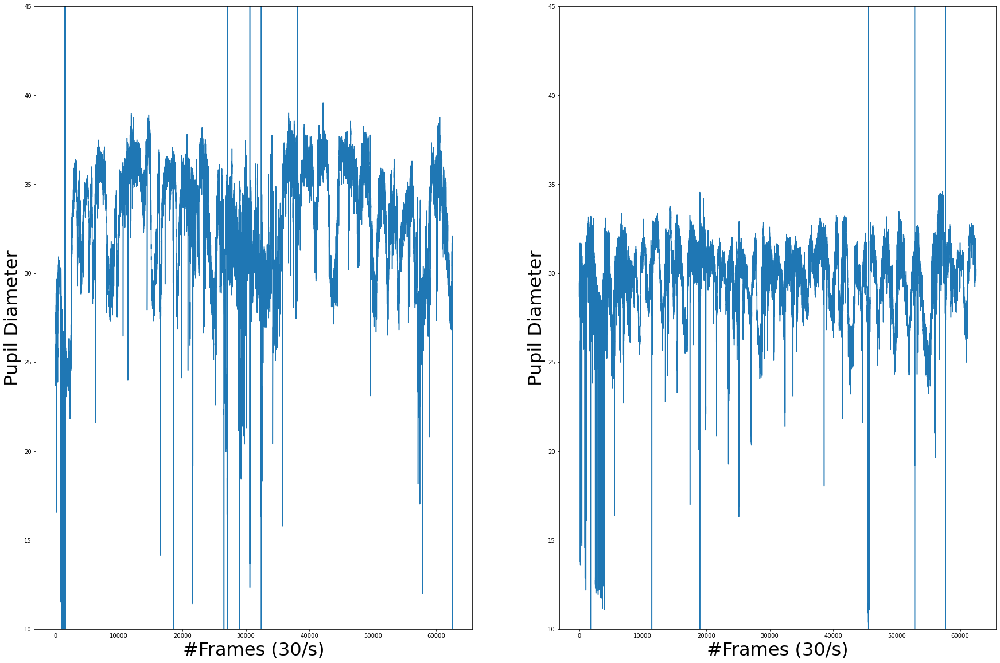

In [78]:
plt.figure(figsize=(30,20))
plt.subplot(1,2,1)
plt.plot(Pup_Diam)
plt.ylabel('Pupil Diameter',fontsize=32)
plt.xlabel('#Frames (30/s)',fontsize=32)
plt.ylim([10,45])
plt.subplot(1,2,2)
plt.plot(Pup_Diam2)
plt.ylim([10,45])
plt.ylabel('Pupil Diameter',fontsize=32)
plt.xlabel('#Frames (30/s)',fontsize=32)

(-2.0, 30.0)

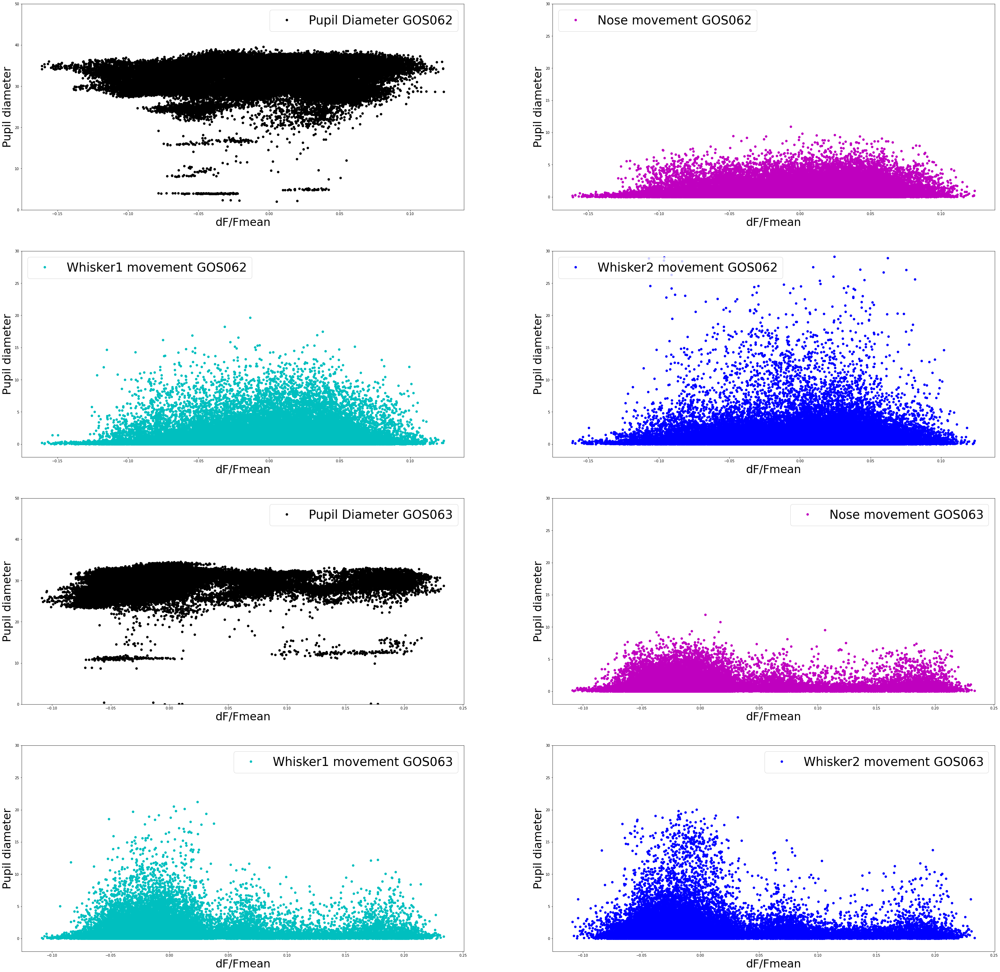

In [76]:
#SCATTER PLOTS with 4s delay (120 frames) MOUSE 1
plt.figure(figsize=(50,50))
sensor_time = 1
Time_cons = 30*sensor_time
plt.subplot(4,2,1)
plt.plot(dF_Fmean[Time_cons:len(dF_Fmean)],Pup_Diam[0:(len(dF_Fmean)-Time_cons),0],'ko')
plt.legend(['Pupil Diameter GOS062'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([0,50])
plt.subplot(4,2,2)
plt.plot(dF_Fmean[Time_cons:len(dF_Fmean)],Nose_move[0:(len(dF_Fmean)-Time_cons),0],'mo')
plt.legend(['Nose movement GOS062'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([-2,30])
plt.subplot(4,2,3)
plt.plot(dF_Fmean[Time_cons:len(dF_Fmean)],Whisker1_move[0:(len(dF_Fmean)-Time_cons),0],'co')
plt.legend(['Whisker1 movement GOS062'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([-2,30])
plt.subplot(4,2,4)
plt.plot(dF_Fmean[Time_cons:len(dF_Fmean)],Whisker2_move[0:(len(dF_Fmean)-Time_cons),0],'bo')
plt.legend(['Whisker2 movement GOS062'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([-2,30])
#SCATTER PLOTS with 4s delay (120 frames) MOUSE2
sensor_time = 4
Time_cons = 30*sensor_time
plt.subplot(4,2,5)
plt.plot(dF_Fmean2[Time_cons:len(dF_Fmean2)],Pup_Diam2[0:(len(dF_Fmean2)-Time_cons),0],'ko')
plt.legend(['Pupil Diameter GOS063'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([0,50])
plt.subplot(4,2,6)
plt.plot(dF_Fmean2[Time_cons:len(dF_Fmean2)],Nose_move2[0:(len(dF_Fmean2)-Time_cons),0],'mo')
plt.legend(['Nose movement GOS063'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([-2,30])
plt.subplot(4,2,7)
plt.plot(dF_Fmean2[Time_cons:len(dF_Fmean2)],Whisker1_move2[0:(len(dF_Fmean2)-Time_cons),0],'co')
plt.legend(['Whisker1 movement GOS063'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([-2,30])
plt.subplot(4,2,8)
plt.plot(dF_Fmean2[Time_cons:len(dF_Fmean2)],Whisker2_move2[0:(len(dF_Fmean2)-Time_cons),0],'bo')
plt.legend(['Whisker2 movement GOS063'], prop={'size': 35})
plt.xlabel('dF/Fmean',fontsize=32)
plt.ylabel('Pupil diameter',fontsize=32);
plt.ylim([-2,30])

In [5]:
#Smooth by moving average (NOT SEPARATED WINDOWS!), Moving window = 10
Pup_smooth = np.convolve(Pup_Diam[:,0], np.ones(10), 'valid') / 10
Nose_smooth = np.convolve(Nose_move[:,0], np.ones(10), 'valid') / 10
Whisker1_smooth = np.convolve(Whisker1_move[:,0], np.ones(10), 'valid') / 10
Whisker2_smooth = np.convolve(Whisker2_move[:,0], np.ones(10), 'valid') / 10
dF_Fsmooth =  np.convolve(dF_Fmean[:], np.ones(10), 'valid') / 10
dF_Fsmooth2 = np.convolve(dF_Fmean2[:], np.ones(10), 'valid') / 10
Pup2_smooth = np.convolve(Pup_Diam2[:,0], np.ones(10), 'valid') / 10
Nose_smooth2 = np.convolve(Nose_move2[:,0], np.ones(10), 'valid') / 10
Whisker1_smooth2 = np.convolve(Whisker1_move2[:,0], np.ones(10), 'valid') / 10
Whisker2_smooth2 = np.convolve(Whisker2_move2[:,0], np.ones(10), 'valid') / 10



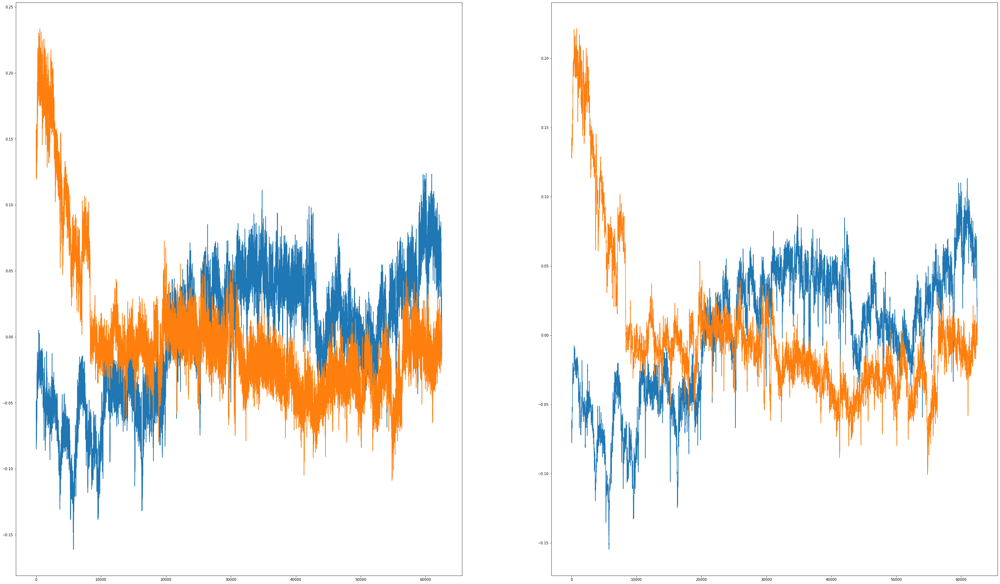

In [17]:
#Plot dF_Fmean raw versus smoothed
plt.figure(figsize=[50,30])
plt.subplot(1,2,1)
plt.plot(dF_Fmean)
plt.plot(dF_Fmean2)
plt.subplot(1,2,2)
plt.plot(dF_Fsmooth)
plt.plot(dF_Fsmooth2)

In [ ]:
wind = 30
corrs_neg=np.zeros([1,3])
corrs_pos=np.zeros([1,3])
crosscorr_vec = np.zeros([1,6])
if var1>var2:
    var1=var1[0:len(var2)
if var2>var1:
    var2=var2[0:len(var1)
for ii in range(0,2):
  tmp = dF_Fsmooth[ii*wind:len(dF_Fsmooth)]
  tmp2 = Pup_smooth[ii*wind:len(Pup_smooth)]
  corrs_neg[0,ii]=np.correlate(tmp,Pup_smooth[0:len(tmp)],mode='valid')
  corrs_pos[0,ii]=np.correlate(dF_Fsmooth[0:len(tmp2)],tmp2,mode='valid')
crosscorr_vec =np.concatenate(corrs_neg,corrs_pos,axis=1)


ERROR! Session/line number was not unique in database. History logging moved to new session 78


In [55]:
#Function to Calculate cross-correlation with time lag wind of variable var1 and var2. It returns 200 values, 100 with the delay of the second variable (inversed order) and 100 with the delay of the first variable (default order) 
def cross_corr(var1,var2,wind):
 corrs_pos = np.zeros([1,100])   
 corrs_neg = np.zeros([1,100])
 corr_both = np.zeros([1,200])
 if len(var1)>len(var2):
     var1=var1[0:len(var2)]
 if len(var2)>len(var1):
     var2=var2[0:len(var1)]
 for ii in range(0,99):
   tmp = var1[ii*wind:len(var1)]
   tmp2 = var2[ii*wind:len(var2)]
   corrs_pos[0,ii]=np.correlate(tmp,var2[0:len(tmp)],mode='valid')
   corrs_neg[0,99-ii]=np.correlate(var1[0:len(tmp2)],tmp2,mode='valid')
 corr_both[0,0:100]=corrs_neg
 corr_both[0,100:200]=corrs_pos
 return corr_both

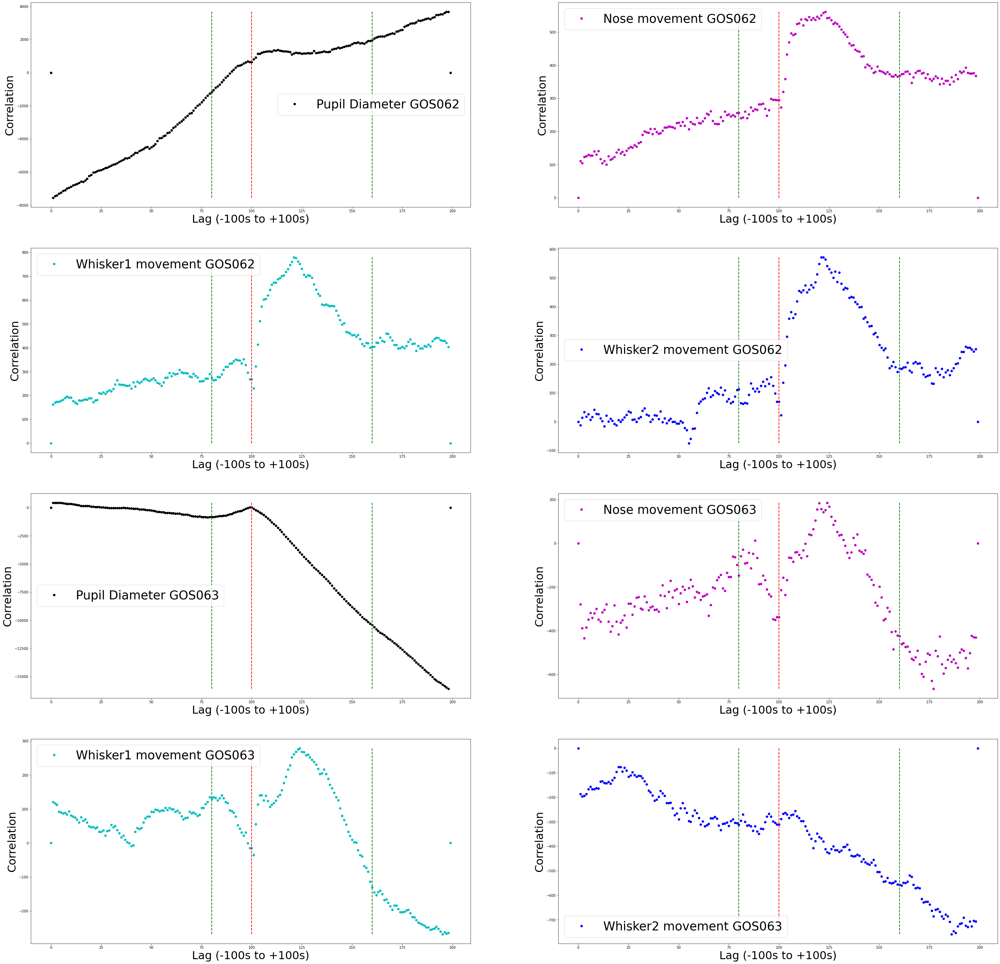

In [73]:
plt.figure(figsize=[50,50])
plt.plot(a[0,:])
plt.subplot(4,2,1)
a = cross_corr(dF_Fsmooth,Pup_smooth,30)
plt.plot(a[0,:],'ko')
plt.legend(['Pupil Diameter GOS062'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])
plt.subplot(4,2,2)
a = cross_corr(dF_Fsmooth,Nose_smooth,30)
plt.plot(a[0,:],'mo')
plt.legend(['Nose movement GOS062'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])
plt.subplot(4,2,3)
a = cross_corr(dF_Fsmooth,Whisker1_smooth,30)
plt.plot(a[0,:],'co')
plt.legend(['Whisker1 movement GOS062'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])
plt.subplot(4,2,4)
a = cross_corr(dF_Fsmooth,Whisker2_smooth,30)
plt.plot(a[0,:],'bo')
plt.legend(['Whisker2 movement GOS062'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])
#MOUSE2
plt.subplot(4,2,5)
a = cross_corr(dF_Fsmooth2,Pup2_smooth,30)
plt.plot(a[0,:],'ko')
plt.legend(['Pupil Diameter GOS063'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])
plt.subplot(4,2,6)
a = cross_corr(dF_Fsmooth2,Nose_smooth2,30)
plt.plot(a[0,:],'mo')
plt.legend(['Nose movement GOS063'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])
plt.subplot(4,2,7)
a = cross_corr(dF_Fsmooth2,Whisker1_smooth2,30)
plt.plot(a[0,:],'co')
plt.legend(['Whisker1 movement GOS063'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])
plt.subplot(4,2,8)
a = cross_corr(dF_Fsmooth2,Whisker2_smooth,30)
plt.plot(a[0,:],'bo')
plt.legend(['Whisker2 movement GOS063'], prop={'size': 35})
plt.xlabel('Lag (-100s to +100s)',fontsize=32)
plt.ylabel('Correlation',fontsize=32);
plt.plot([100,100], [min(a[0,:]),max(a[0,:])], 'r--', lw=2)
plt.plot([80,80], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
plt.plot([160,160], [min(a[0,:]),max(a[0,:])], 'g--', lw=2)
#plt.ylim([0,50])